In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os

#Define the paths to the dataset folders
train_image_folder = '/content/drive/MyDrive/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation 2/train/Original'
train_mask_folder = '/content/drive/MyDrive/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation 2/train/Ground_truth'

valid_image_folder = '/content/drive/MyDrive/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation 2/validation/Original'
valid_mask_folder = '/content/drive/MyDrive/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation 2/validation/Ground_truth'

test_image_folder = '/content/drive/MyDrive/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation 2/test/Original'
test_mask_folder = '/content/drive/MyDrive/FIVES A Fundus Image Dataset for AI-based Vessel Segmentation 2/test/Ground_truth'

#Use os.listdir() to get the list of file names in each folder
train_image_files = os.listdir(train_image_folder)
train_mask_files = os.listdir(train_mask_folder)

valid_image_files = os.listdir(valid_image_folder)
valid_mask_files = os.listdir(valid_mask_folder)

test_image_files = os.listdir(test_image_folder)
test_mask_files = os.listdir(test_mask_folder)

#Create full file paths
train_image_paths = [os.path.join(train_image_folder, filename) for filename in train_image_files]
train_mask_paths = [os.path.join(train_mask_folder, filename) for filename in train_mask_files]

valid_image_paths = [os.path.join(valid_image_folder, filename) for filename in valid_image_files]
valid_mask_paths = [os.path.join(valid_mask_folder, filename) for filename in valid_mask_files]

test_image_paths = [os.path.join(test_image_folder, filename) for filename in test_image_files]
test_mask_paths = [os.path.join(test_mask_folder, filename) for filename in test_mask_files]


In [3]:
train_image_paths = sorted(train_image_paths)
train_mask_paths = sorted(train_mask_paths)

valid_image_paths = sorted(valid_image_paths)
valid_mask_paths = sorted(valid_mask_paths)

test_image_paths = sorted(test_image_paths)
test_mask_paths = sorted(test_mask_paths)

In [4]:
print(len(train_mask_paths))
print(len(train_image_paths))

480
480


In [7]:
import tensorflow as tf
BATCH_SIZE = 8
IMAGE_SIZE = 256


def read_image(image_path, mask=False):
    image = tf.io.read_file(image_path)

    if mask:
        image = tf.image.decode_png(image, channels=1)
        image = tf.cast(image, tf.float32) / 255.0  # Normalize to [0, 1] for mask images
        image = tf.where(image >= 0.5, 1.0, 0.0)
        image = tf.image.resize(image, [IMAGE_SIZE, IMAGE_SIZE])
    else:
        image = tf.image.decode_png(image, channels=3)
        image = tf.cast(image, tf.float32) / 255.0  # Normalize to [0, 1] for RGB images
        image = tf.image.resize(image, [IMAGE_SIZE, IMAGE_SIZE])

    return image


def augment_data(image, mask):
    # Randomly flip the image and mask horizontally
    if tf.random.uniform(()) > 0.5:
        image = tf.image.flip_left_right(image)
        mask = tf.image.flip_left_right(mask)

     # Randomly flip the image and mask vertically
    if tf.random.uniform(()) > 0.5:
        image = tf.image.flip_up_down(image)
        mask = tf.image.flip_up_down(mask)

    # Randomly rotate the image and mask with range -30 to 30 degree
    angle = tf.random.uniform((), minval=-30, maxval=30, dtype=tf.float32)
    image = tf.image.rot90(image, k=tf.cast(angle / 30, dtype=tf.int32))
    mask = tf.image.rot90(mask, k=tf.cast(angle / 30, dtype=tf.int32))

    return image, mask


def load_data(image_list, mask_list):
    image = read_image(image_list)
    mask = read_image(mask_list, mask=True)
    return image, mask


def data_generator(image_list, mask_list, augment=False, batch_size=None):
    dataset = tf.data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)

    if augment:
        dataset = dataset.map(augment_data, num_parallel_calls=tf.data.AUTOTUNE)

    if batch_size is not None:
        dataset = dataset.batch(batch_size, drop_remainder=True)

    return dataset

# Create augmented train_dataset with a specific batch size
train_dataset = data_generator(train_image_paths, train_mask_paths, augment=True, batch_size=BATCH_SIZE)

# Create validation dataset without augmentation
val_dataset = data_generator(valid_image_paths, valid_mask_paths, batch_size=BATCH_SIZE)

print("Train Dataset:", train_dataset)
print("Val Dataset:", val_dataset)


Train Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(8, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(8, 256, 256, 1), dtype=tf.float32, name=None))>
Val Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(8, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(8, 256, 256, 1), dtype=tf.float32, name=None))>


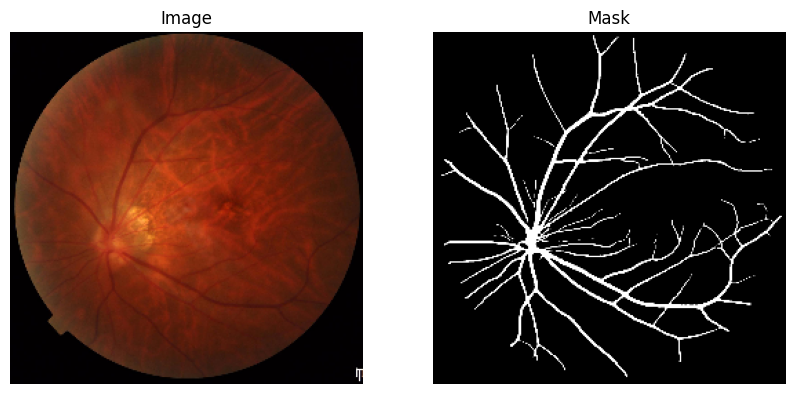

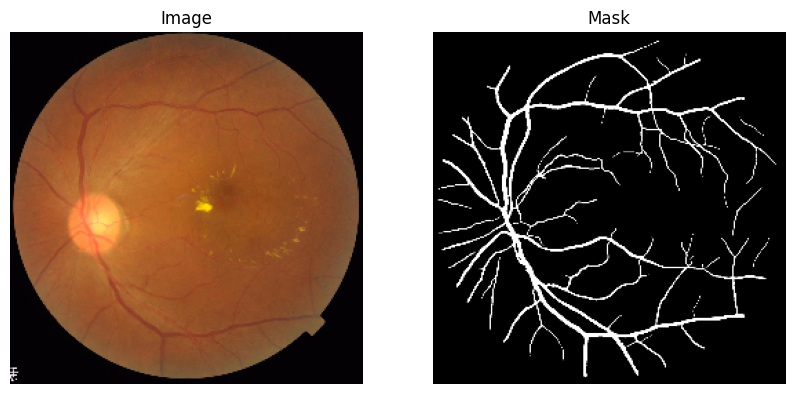

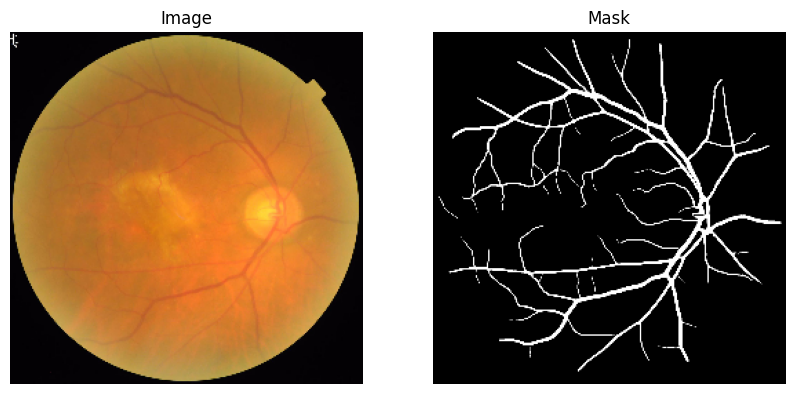

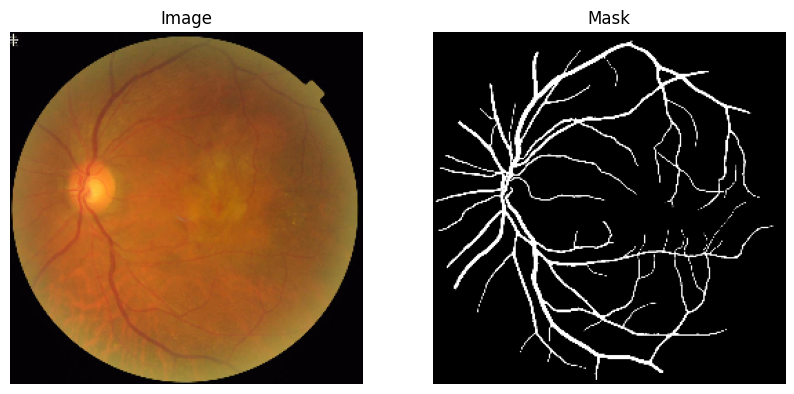

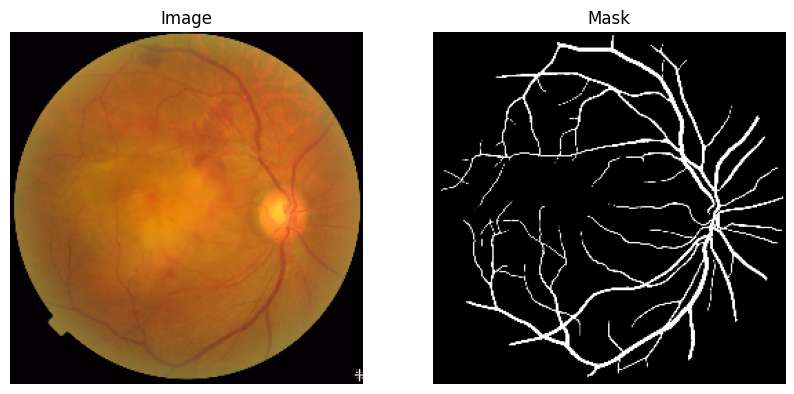

...

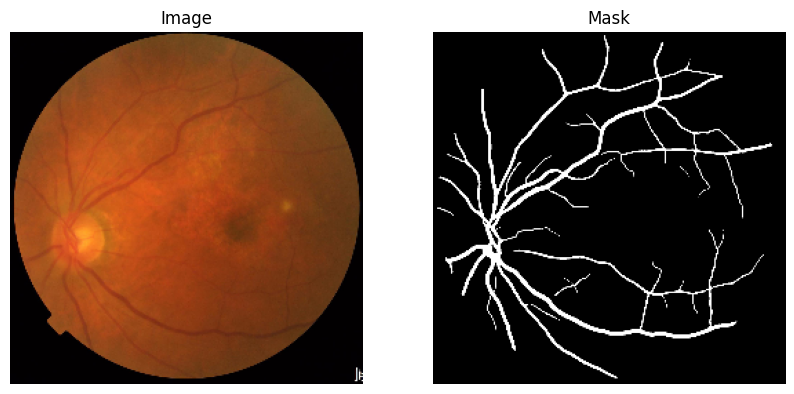

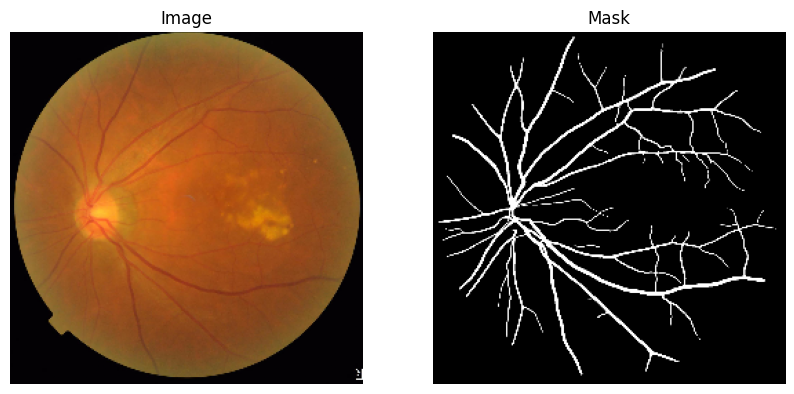

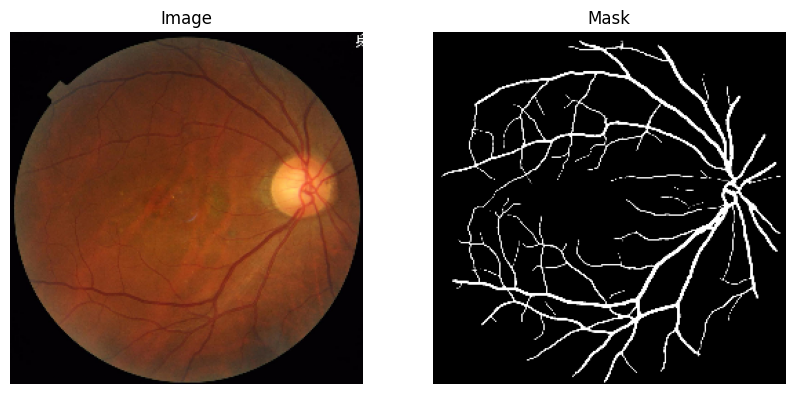

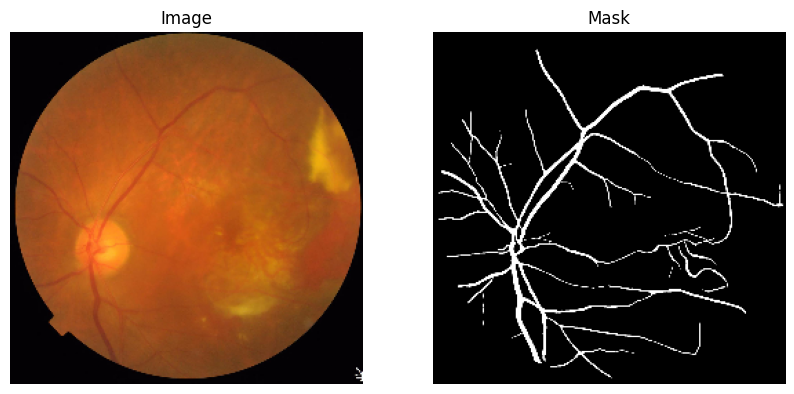

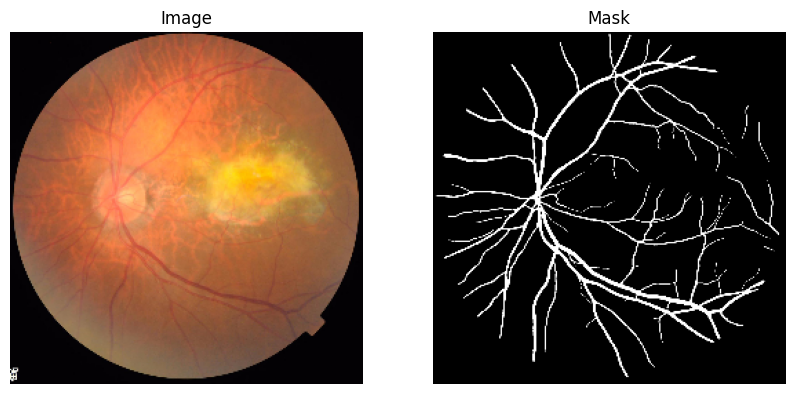

In [8]:
import matplotlib.pyplot as plt

plot_count = 0

for image_batch, mask_batch in train_dataset:
    batch_size = image_batch.shape[0]
    for i in range(batch_size):
        if plot_count >= 20:
            break

        plt.figure(figsize=(10, 5))

        plt.subplot(1, 2, 1)
        plt.imshow(image_batch[i].numpy())
        plt.title("Image")
        plt.axis('off')

        plt.subplot(1, 2, 2)
        plt.imshow(mask_batch[i].numpy(), cmap='gray')
        plt.title("Mask")
        plt.axis('off')

        plt.show()

        plot_count += 1

    if plot_count >= 20:
        break


In [9]:
from IPython.display import clear_output as cls
!pip install tf_explain
cls()


In [10]:
import numpy as np

def show_images(data, model=None, explain=False, n_images=6, SIZE=(25,10)):

    # Plot Configurations
    if model is not None:
        if explain:
            n_cols = 8
        else:
            n_cols = 4
    else:
        n_cols = 3

    # Iterate through data
    for plot_no in range(1, n_images+1):
        for index, (images, masks) in enumerate(iter(data)):

            # Select Items
            id = np.random.randint(len(images))
            image, mask = images[id], masks[id]

            if model is not None:

                if explain:

                    # Make Prediction
                    pred_mask = model.predict(image[np.newaxis, ...])[0]

                    image_numpy = image.numpy()

                    image_with_batch = image_numpy[np.newaxis, ...]

                    # Grad CAM
                    cam = GradCAM()
                    cam = cam.explain(
                        validation_data=(image_with_batch, masks[id]),
                        model=model,
                        class_index=1,
                        layer_name="OutputMask",
                        image_weight=0.5
                    )

                    # Figure
                    plt.figure(figsize=SIZE)

                    # Original Image
                    plt.subplot(1, n_cols, 1)
                    plt.imshow(image)
                    plt.axis('off')
                    plt.title("Original Image")

                    # Original Mask
                    plt.subplot(1, n_cols, 2)
                    plt.imshow(mask, cmap='gray')
                    plt.axis('off')
                    plt.title('Original Mask')

                    # Predicted Mask
                    plt.subplot(1, n_cols, 3)
                    plt.imshow(pred_mask, cmap='gray')
                    plt.axis('off')
                    plt.title("Predicted Mask")

                    # Mixed
                    plt.subplot(1, n_cols, 4)
                    plt.imshow(image)
                    plt.imshow(pred_mask, alpha=0.4)
                    plt.axis('off')
                    plt.title("Overlaped Prediction")

                    # Mixed
                    plt.subplot(1, n_cols, 5)
                    plt.imshow(cam)
                    plt.axis('off')
                    plt.title("Grad CAM")

                    # Show Image
                    plt.show()

                else:
                    # Make Prediction
                    pred_mask = model.predict(image[np.newaxis, ...])[0]


                    # Figure
                    plt.figure(figsize=SIZE)

                    # Original Image
                    plt.subplot(1, n_cols, 1)
                    plt.imshow(image)
                    plt.axis('off')
                    plt.title("Original Image")

                    # Original Mask
                    plt.subplot(1, n_cols, 2)
                    plt.imshow(mask, cmap='gray')
                    plt.axis('off')
                    plt.title('Original Mask')

                    # Predicted Mask
                    plt.subplot(1, n_cols, 3)
                    plt.imshow(pred_mask, cmap='gray')
                    plt.axis('off')
                    plt.title("Predicted Mask")

                    # Mixed
                    plt.subplot(1, n_cols, 4)
                    plt.imshow(image)
                    plt.imshow(pred_mask, alpha=0.4)
                    plt.axis('off')
                    plt.title("Overlaped Prediction")

                    # Show Image
                    plt.show()

            else:

                # Figure
                plt.figure(figsize=SIZE)

                # Original Image
                plt.subplot(1, n_cols, 1)
                plt.imshow(image)
                plt.axis('off')
                plt.title("Original Image")

                # Original Mask
                plt.subplot(1, n_cols, 2)
                plt.imshow(mask, cmap='gray')
                plt.axis('off')
                plt.title('Original Mask')

                # Mixed
                plt.subplot(1, n_cols, 3)
                plt.imshow(image)
                plt.imshow(mask, alpha=0.4)
                plt.axis('off')
                plt.title("Overlaped Image")

                # Show Image
                plt.show()

            # Break Loop
            break

In [11]:
import os
import keras
import numpy as np
from glob import glob
from tqdm import tqdm

# Data Visualization
import matplotlib.pyplot as plt

# Model
from keras.layers import ReLU
from keras.layers import Input
from keras.layers import Layer
from keras.layers import Conv2D
from keras.layers import Concatenate
from keras.layers import UpSampling2D
from keras.layers import AveragePooling2D
from keras.models import Sequential, Model
from keras.layers import BatchNormalization

# Pretrained Model
from tensorflow.keras.applications import DenseNet121

# Callbacks
from keras.callbacks import Callback, ModelCheckpoint

# Model Visualization
from tensorflow.keras.utils import plot_model

# Model Explaination
from tf_explain.core.grad_cam import GradCAM

In [12]:
@keras.utils.register_keras_serializable(package="Custom", name="ConvBlock")
class ConvBlock(Layer):

    def __init__(self, filters=256, kernel_size=3, dilation_rate=1, **kwargs):
        super(ConvBlock, self).__init__(**kwargs)

        self.filters = filters
        self.kernel_size = kernel_size
        self.dilation_rate = dilation_rate

        self.net = Sequential([
            Conv2D(filters, kernel_size=kernel_size, padding='same', dilation_rate=dilation_rate, use_bias=False, kernel_initializer='he_normal'),
            BatchNormalization(),
            ReLU()
        ])

    def call(self, X):
        return self.net(X)

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            "kernel_size":self.kernel_size,
            "dilation_rate":self.dilation_rate,
        }


In [13]:
def AtrousSpatialPyramidPooling(X):
    B, H, W, C = X.shape

    # Image Pooling
    image_pool = AveragePooling2D(pool_size=(H, W), name="ASPP-AvgPool")(X)
    image_pool = ConvBlock(kernel_size=1, name="ASPP-ImagePool-CB")(image_pool)
    image_pool = UpSampling2D(size=(H//image_pool.shape[1], W//image_pool.shape[2]), name="ASPP-ImagePool-UpSample")(image_pool)

    # Atrous Oprtations
    conv_1  = ConvBlock(kernel_size=1, dilation_rate=1, name="ASPP-CB-1")(X)
    conv_6  = ConvBlock(kernel_size=3, dilation_rate=6, name="ASPP-CB-6")(X)
    conv_12 = ConvBlock(kernel_size=3, dilation_rate=12, name="ASPP-CB-12")(X)
    conv_18 = ConvBlock(kernel_size=3, dilation_rate=18, name="ASPP-CB-18")(X)

    # Combine All
    combined = Concatenate(name="ASPP-Combine")([image_pool, conv_1, conv_6, conv_12, conv_18])
    processed = ConvBlock(kernel_size=1, name="ASPP-Net")(combined)

    # Final Output
    return processed

In [14]:

IMAGE_SIZE = 256

# Input
InputL = Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3), name="InputLayer")

# Base Mode
backbone = DenseNet121(include_top=False, weights='imagenet', input_tensor=InputL)

print(backbone)
# ASPP Phase
DCNN = backbone.get_layer('conv5_block6_1_conv').output
print(DCNN.shape)
ASPP = AtrousSpatialPyramidPooling(DCNN)
ASPP = UpSampling2D(size=(IMAGE_SIZE//4//ASPP.shape[1], IMAGE_SIZE//4//ASPP.shape[2]), name="AtrousSpatial")(ASPP)

# LLF Phase
LLF = backbone.get_layer('conv2_block4_1_conv').output
LLF = ConvBlock(filters=48, kernel_size=1, name="LLF-ConvBlock")(LLF)

# Combined
combined = Concatenate(axis=-1, name="Combine-LLF-ASPP")([ASPP, LLF])
features = ConvBlock(name="Top-ConvBlock-1")(combined)
features = ConvBlock(name="Top-ConvBlock-2")(features)
upsample = UpSampling2D(size=(IMAGE_SIZE//features.shape[1], IMAGE_SIZE//features.shape[1]), interpolation='bilinear', name="Top-UpSample")(features)

# Output Mask
PredMask = Conv2D(1, kernel_size=3, strides=1, padding='same', activation='sigmoid', use_bias=False, name="OutputMask")(upsample)

# DeelLabV3+ Model
model = Model(InputL, PredMask, name="DeepLabV3-Plus")
model.summary()

29084464/29084464 [==============================] - 2s 0us/step
(None, 8, 8, 128)
Model: "DeepLabV3-Plus"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 InputLayer (InputLayer)     [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 zero_padding2d (ZeroPaddin  (None, 262, 262, 3)          0         ['InputLayer[0][0]']          
 g2D)                                                                                             
                                                                                                  
 conv1/conv (Conv2D)         (None, 128, 128, 64)         9408      ['zero_padding2d[0][0]']      
                                                                                                  
 c

In [15]:
import keras
from keras import backend as K

def dice_coef(y_true, y_pred, smooth=1):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def dice_loss(y_true, y_pred):
    smooth = 1.
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = y_true_f * y_pred_f
    score = (2. * K.sum(intersection) + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
    return 1. - score

def bce_dice_loss(y_true, y_pred):
    return tf.keras.losses.binary_crossentropy(y_true, y_pred) + dice_loss(y_true, y_pred)

keras.utils.get_custom_objects()['bce_dice_loss'] = bce_dice_loss


In [16]:

model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate=0.001), loss = bce_dice_loss, metrics=[dice_coef, "accuracy"])


Epoch 1/100
60/60 [==============================] - ETA: 0s - loss: 0.6953 - dice_coef: 0.5051 - accuracy: 0.9160

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


60/60 [==============================] - 140s 1s/step - loss: 0.6953 - dice_coef: 0.5051 - accuracy: 0.9160 - val_loss: 1.2101 - val_dice_coef: 0.0774 - val_accuracy: 0.9191
Epoch 2/100
60/60 [==============================] - 14s 222ms/step - loss: 0.4559 - dice_coef: 0.6687 - accuracy: 0.9523 - val_loss: 1.5247 - val_dice_coef: 0.0023 - val_accuracy: 0.9191
Epoch 3/100
60/60 [==============================] - 13s 216ms/step - loss: 0.4088 - dice_coef: 0.7044 - accuracy: 0.9567 - val_loss: 1.5776 - val_dice_coef: 0.0017 - val_accuracy: 0.9191
Epoch 4/100
60/60 [==============================] - 14s 219ms/step - loss: 0.3826 - dice_coef: 0.7243 - accuracy: 0.9591 - val_loss: 1.5538 - val_dice_coef: 0.0058 - val_accuracy: 0.9191
Epoch 5/100
60/60 [==============================] - 14s 235ms/step - loss: 0.3647 - dice_coef: 0.7379 - accuracy: 0.9608 - val_loss: 1.3196 - val_dice_coef: 0.0966 - val_accuracy: 0.9201
Epoch 6/100
60/60 [==============================] - 14s 232ms/step - loss

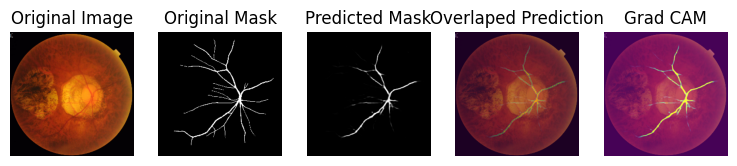

1/1 [==============================] - 0s 79ms/step


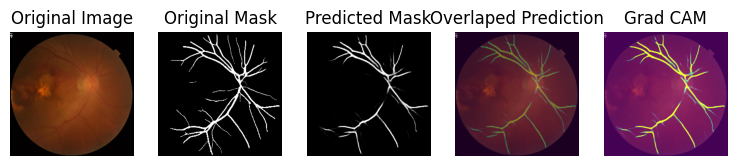

1/1 [==============================] - 0s 69ms/step


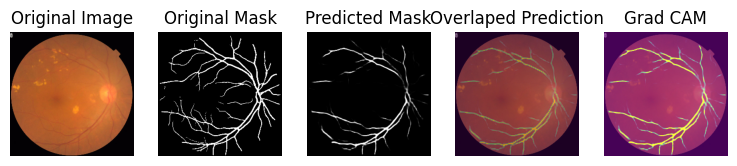

60/60 [==============================] - 21s 341ms/step - loss: 0.3228 - dice_coef: 0.7703 - accuracy: 0.9645 - val_loss: 0.4326 - val_dice_coef: 0.6998 - val_accuracy: 0.9594
Epoch 11/100
60/60 [==============================] - 13s 216ms/step - loss: 0.3189 - dice_coef: 0.7734 - accuracy: 0.9647 - val_loss: 0.4560 - val_dice_coef: 0.6790 - val_accuracy: 0.9585
Epoch 12/100
60/60 [==============================] - 14s 236ms/step - loss: 0.3134 - dice_coef: 0.7771 - accuracy: 0.9653 - val_loss: 0.3894 - val_dice_coef: 0.7247 - val_accuracy: 0.9616
Epoch 13/100
60/60 [==============================] - 15s 246ms/step - loss: 0.3122 - dice_coef: 0.7789 - accuracy: 0.9654 - val_loss: 0.3779 - val_dice_coef: 0.7318 - val_accuracy: 0.9631
Epoch 14/100
60/60 [==============================] - 13s 216ms/step - loss: 0.3059 - dice_coef: 0.7831 - accuracy: 0.9659 - val_loss: 0.3992 - val_dice_coef: 0.7125 - val_accuracy: 0.9619
Epoch 15/100
60/60 [==============================] - 13s 215ms/step

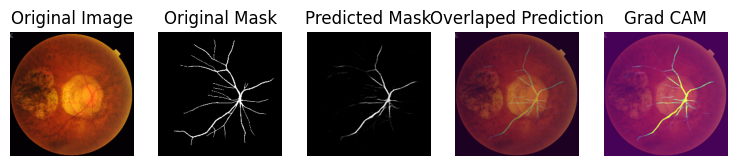

1/1 [==============================] - 0s 69ms/step


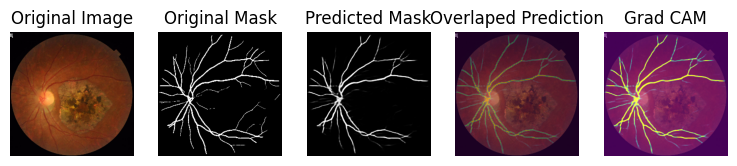

1/1 [==============================] - 0s 70ms/step


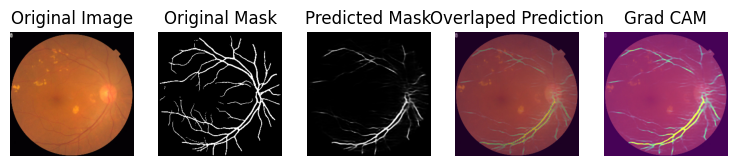

60/60 [==============================] - 17s 276ms/step - loss: 0.2868 - dice_coef: 0.7970 - accuracy: 0.9676 - val_loss: 0.4167 - val_dice_coef: 0.6873 - val_accuracy: 0.9603
Epoch 21/100
60/60 [==============================] - 13s 218ms/step - loss: 0.2846 - dice_coef: 0.7988 - accuracy: 0.9678 - val_loss: 0.3432 - val_dice_coef: 0.7530 - val_accuracy: 0.9638
Epoch 22/100
60/60 [==============================] - 13s 218ms/step - loss: 0.2832 - dice_coef: 0.8001 - accuracy: 0.9680 - val_loss: 0.3586 - val_dice_coef: 0.7377 - val_accuracy: 0.9626
Epoch 23/100
60/60 [==============================] - 13s 215ms/step - loss: 0.2829 - dice_coef: 0.8010 - accuracy: 0.9681 - val_loss: 0.3539 - val_dice_coef: 0.7432 - val_accuracy: 0.9647
Epoch 24/100
60/60 [==============================] - 14s 234ms/step - loss: 0.2807 - dice_coef: 0.8020 - accuracy: 0.9682 - val_loss: 0.3413 - val_dice_coef: 0.7548 - val_accuracy: 0.9655
Epoch 25/100
60/60 [==============================] - 13s 215ms/step

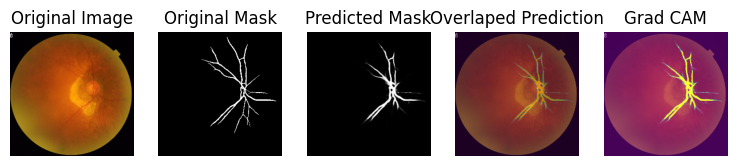

1/1 [==============================] - 0s 50ms/step


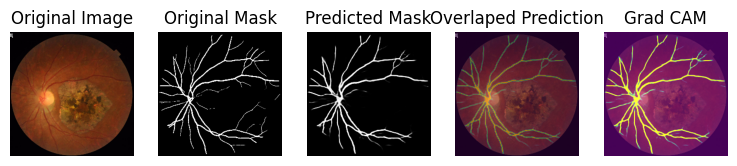

1/1 [==============================] - 0s 57ms/step


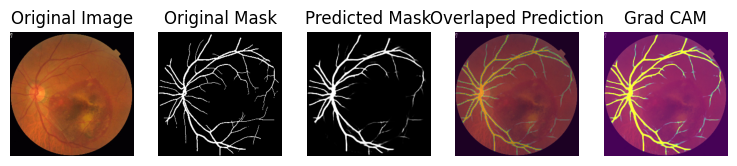

60/60 [==============================] - 17s 278ms/step - loss: 0.2762 - dice_coef: 0.8064 - accuracy: 0.9686 - val_loss: 0.3966 - val_dice_coef: 0.7186 - val_accuracy: 0.9578
Epoch 31/100
60/60 [==============================] - 13s 217ms/step - loss: 0.2740 - dice_coef: 0.8079 - accuracy: 0.9688 - val_loss: 0.3222 - val_dice_coef: 0.7743 - val_accuracy: 0.9637
Epoch 32/100
60/60 [==============================] - 13s 215ms/step - loss: 0.2717 - dice_coef: 0.8090 - accuracy: 0.9689 - val_loss: 0.3265 - val_dice_coef: 0.7610 - val_accuracy: 0.9659
Epoch 33/100
60/60 [==============================] - 13s 218ms/step - loss: 0.2682 - dice_coef: 0.8112 - accuracy: 0.9692 - val_loss: 0.3059 - val_dice_coef: 0.7800 - val_accuracy: 0.9675
Epoch 34/100
60/60 [==============================] - 13s 217ms/step - loss: 0.2669 - dice_coef: 0.8123 - accuracy: 0.9693 - val_loss: 0.3518 - val_dice_coef: 0.7490 - val_accuracy: 0.9646
Epoch 35/100
60/60 [==============================] - 13s 214ms/step

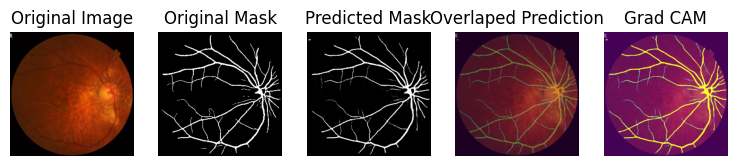

1/1 [==============================] - 0s 62ms/step


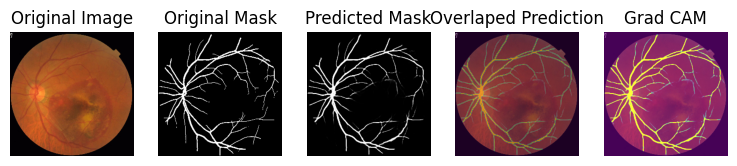

1/1 [==============================] - 0s 51ms/step


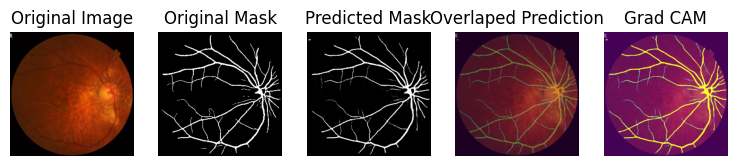

60/60 [==============================] - 18s 302ms/step - loss: 0.2647 - dice_coef: 0.8145 - accuracy: 0.9696 - val_loss: 0.3031 - val_dice_coef: 0.7760 - val_accuracy: 0.9681
Epoch 41/100
60/60 [==============================] - 13s 220ms/step - loss: 0.2619 - dice_coef: 0.8160 - accuracy: 0.9697 - val_loss: 0.3084 - val_dice_coef: 0.7755 - val_accuracy: 0.9675
Epoch 42/100
60/60 [==============================] - 13s 213ms/step - loss: 0.2598 - dice_coef: 0.8173 - accuracy: 0.9699 - val_loss: 0.3409 - val_dice_coef: 0.7494 - val_accuracy: 0.9655
Epoch 43/100
60/60 [==============================] - 13s 219ms/step - loss: 0.2583 - dice_coef: 0.8184 - accuracy: 0.9701 - val_loss: 0.3268 - val_dice_coef: 0.7613 - val_accuracy: 0.9661
Epoch 44/100
60/60 [==============================] - 14s 222ms/step - loss: 0.2577 - dice_coef: 0.8190 - accuracy: 0.9701 - val_loss: 0.3135 - val_dice_coef: 0.7736 - val_accuracy: 0.9670
Epoch 45/100
60/60 [==============================] - 13s 221ms/step

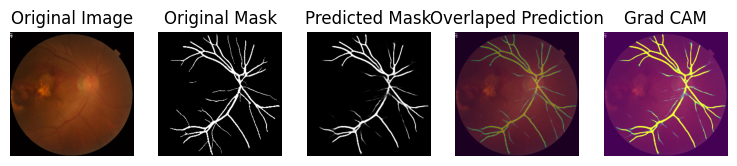

1/1 [==============================] - 0s 77ms/step


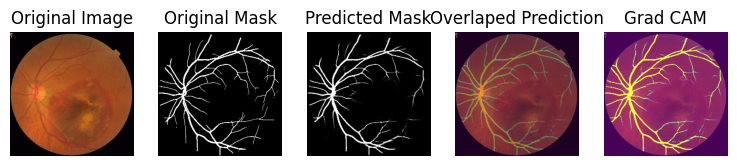

1/1 [==============================] - 0s 49ms/step


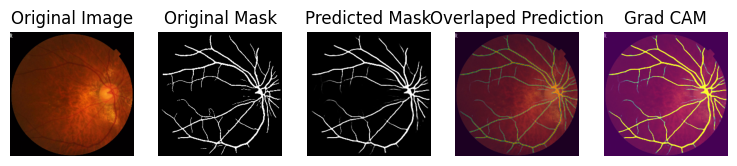

60/60 [==============================] - 17s 279ms/step - loss: 0.2475 - dice_coef: 0.8256 - accuracy: 0.9710 - val_loss: 0.3075 - val_dice_coef: 0.7778 - val_accuracy: 0.9677
Epoch 51/100
60/60 [==============================] - 13s 218ms/step - loss: 0.2487 - dice_coef: 0.8247 - accuracy: 0.9709 - val_loss: 0.3182 - val_dice_coef: 0.7690 - val_accuracy: 0.9672
Epoch 52/100
60/60 [==============================] - 13s 219ms/step - loss: 0.2514 - dice_coef: 0.8240 - accuracy: 0.9706 - val_loss: 0.3676 - val_dice_coef: 0.7623 - val_accuracy: 0.9652
Epoch 53/100
60/60 [==============================] - 14s 237ms/step - loss: 0.2492 - dice_coef: 0.8249 - accuracy: 0.9709 - val_loss: 0.3007 - val_dice_coef: 0.7804 - val_accuracy: 0.9687
Epoch 54/100
60/60 [==============================] - 15s 244ms/step - loss: 0.2454 - dice_coef: 0.8271 - accuracy: 0.9712 - val_loss: 0.2933 - val_dice_coef: 0.7856 - val_accuracy: 0.9691
Epoch 55/100
60/60 [==============================] - 14s 222ms/step

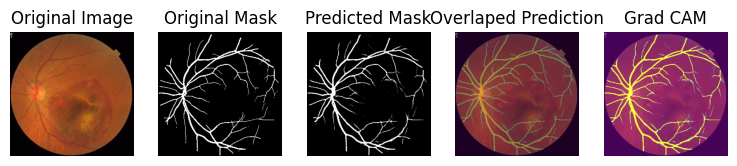

1/1 [==============================] - 0s 76ms/step


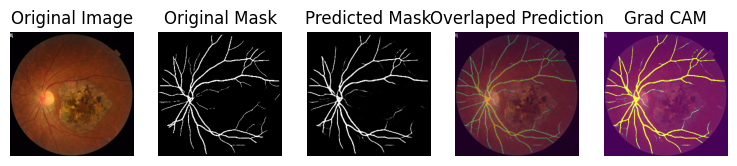

1/1 [==============================] - 0s 51ms/step


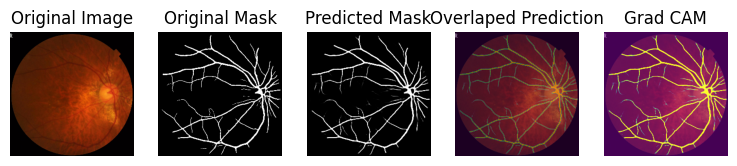

60/60 [==============================] - 18s 299ms/step - loss: 0.2382 - dice_coef: 0.8320 - accuracy: 0.9718 - val_loss: 0.2726 - val_dice_coef: 0.8099 - val_accuracy: 0.9696
Epoch 61/100
60/60 [==============================] - 15s 238ms/step - loss: 0.2377 - dice_coef: 0.8322 - accuracy: 0.9719 - val_loss: 0.2730 - val_dice_coef: 0.8088 - val_accuracy: 0.9698
Epoch 62/100
60/60 [==============================] - 13s 221ms/step - loss: 0.2372 - dice_coef: 0.8326 - accuracy: 0.9719 - val_loss: 0.2772 - val_dice_coef: 0.8025 - val_accuracy: 0.9697
Epoch 63/100
60/60 [==============================] - 13s 219ms/step - loss: 0.2375 - dice_coef: 0.8327 - accuracy: 0.9718 - val_loss: 0.2916 - val_dice_coef: 0.7935 - val_accuracy: 0.9686
Epoch 64/100
60/60 [==============================] - 13s 216ms/step - loss: 0.2388 - dice_coef: 0.8320 - accuracy: 0.9717 - val_loss: 0.2951 - val_dice_coef: 0.7904 - val_accuracy: 0.9686
Epoch 65/100
60/60 [==============================] - 13s 221ms/step

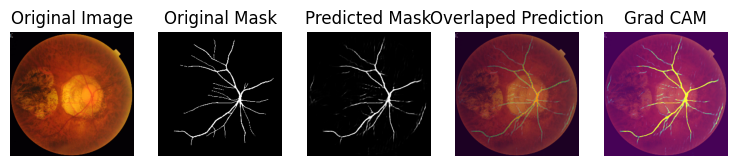

1/1 [==============================] - 0s 59ms/step


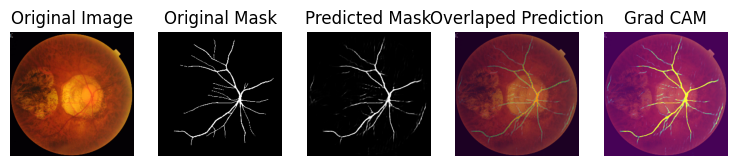

1/1 [==============================] - 0s 59ms/step


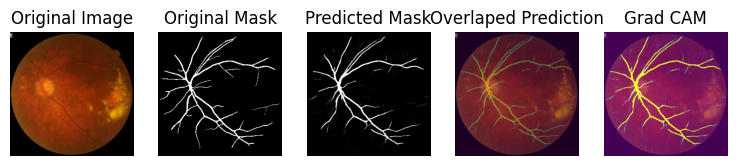

60/60 [==============================] - 17s 281ms/step - loss: 0.2424 - dice_coef: 0.8300 - accuracy: 0.9712 - val_loss: 0.3244 - val_dice_coef: 0.7671 - val_accuracy: 0.9668
Epoch 71/100
60/60 [==============================] - 13s 221ms/step - loss: 0.2411 - dice_coef: 0.8307 - accuracy: 0.9713 - val_loss: 0.3062 - val_dice_coef: 0.7899 - val_accuracy: 0.9686
Epoch 72/100
60/60 [==============================] - 13s 218ms/step - loss: 0.2414 - dice_coef: 0.8304 - accuracy: 0.9713 - val_loss: 0.3013 - val_dice_coef: 0.7882 - val_accuracy: 0.9683
Epoch 73/100
60/60 [==============================] - 13s 215ms/step - loss: 0.2387 - dice_coef: 0.8322 - accuracy: 0.9716 - val_loss: 0.3265 - val_dice_coef: 0.7807 - val_accuracy: 0.9658
Epoch 74/100
60/60 [==============================] - 13s 218ms/step - loss: 0.2364 - dice_coef: 0.8337 - accuracy: 0.9718 - val_loss: 0.3533 - val_dice_coef: 0.7699 - val_accuracy: 0.9646
Epoch 75/100
60/60 [==============================] - 13s 217ms/step

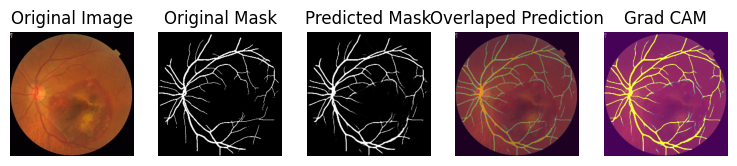

1/1 [==============================] - 0s 79ms/step


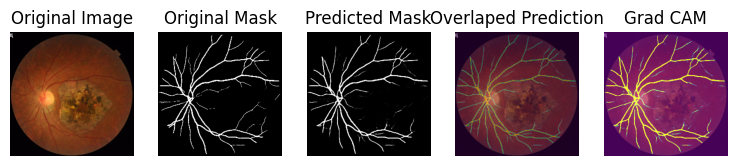

1/1 [==============================] - 0s 65ms/step


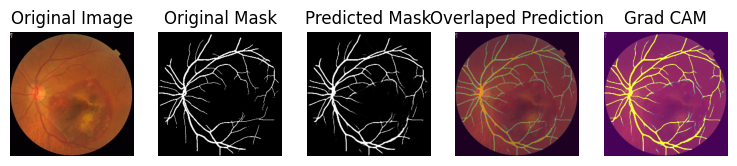

60/60 [==============================] - 18s 297ms/step - loss: 0.2295 - dice_coef: 0.8380 - accuracy: 0.9725 - val_loss: 0.2652 - val_dice_coef: 0.8124 - val_accuracy: 0.9701
Epoch 81/100
60/60 [==============================] - 13s 220ms/step - loss: 0.2281 - dice_coef: 0.8390 - accuracy: 0.9726 - val_loss: 0.3206 - val_dice_coef: 0.7710 - val_accuracy: 0.9677
Epoch 82/100
60/60 [==============================] - 13s 219ms/step - loss: 0.2276 - dice_coef: 0.8393 - accuracy: 0.9726 - val_loss: 0.2970 - val_dice_coef: 0.7908 - val_accuracy: 0.9690
Epoch 83/100
60/60 [==============================] - 15s 237ms/step - loss: 0.2270 - dice_coef: 0.8395 - accuracy: 0.9726 - val_loss: 0.2679 - val_dice_coef: 0.8163 - val_accuracy: 0.9704
Epoch 84/100
60/60 [==============================] - 14s 224ms/step - loss: 0.2311 - dice_coef: 0.8378 - accuracy: 0.9722 - val_loss: 0.3462 - val_dice_coef: 0.7551 - val_accuracy: 0.9659
Epoch 85/100
60/60 [==============================] - 13s 217ms/step

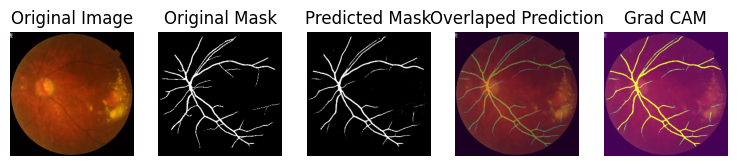

1/1 [==============================] - 0s 67ms/step


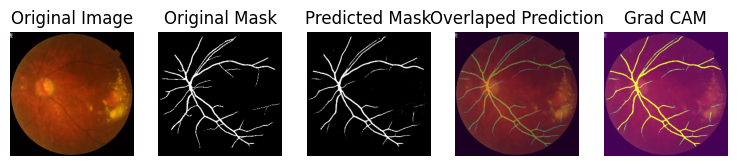

1/1 [==============================] - 0s 57ms/step


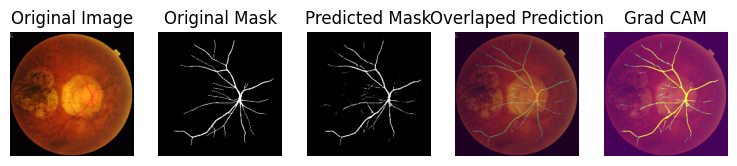

60/60 [==============================] - 17s 277ms/step - loss: 0.2359 - dice_coef: 0.8348 - accuracy: 0.9719 - val_loss: 0.2844 - val_dice_coef: 0.8002 - val_accuracy: 0.9697
Epoch 91/100
60/60 [==============================] - 14s 220ms/step - loss: 0.2321 - dice_coef: 0.8373 - accuracy: 0.9721 - val_loss: 0.3051 - val_dice_coef: 0.7866 - val_accuracy: 0.9685
Epoch 92/100
60/60 [==============================] - 13s 220ms/step - loss: 0.2417 - dice_coef: 0.8313 - accuracy: 0.9713 - val_loss: 0.3157 - val_dice_coef: 0.7926 - val_accuracy: 0.9680
Epoch 93/100
60/60 [==============================] - 13s 221ms/step - loss: 0.2312 - dice_coef: 0.8372 - accuracy: 0.9724 - val_loss: 0.2767 - val_dice_coef: 0.8089 - val_accuracy: 0.9701
Epoch 94/100
60/60 [==============================] - 14s 236ms/step - loss: 0.2288 - dice_coef: 0.8391 - accuracy: 0.9725 - val_loss: 0.2737 - val_dice_coef: 0.8076 - val_accuracy: 0.9704
Epoch 95/100
60/60 [==============================] - 14s 222ms/step

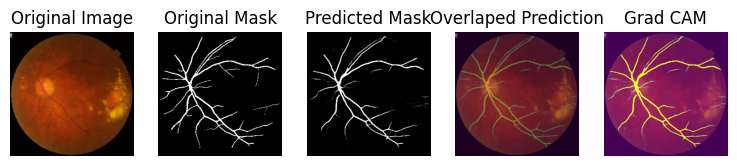

1/1 [==============================] - 0s 51ms/step


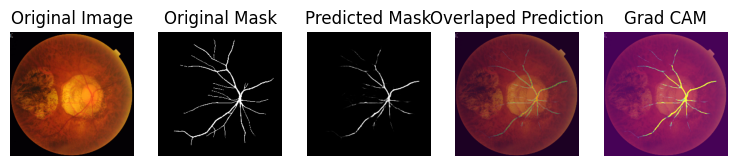

1/1 [==============================] - 0s 54ms/step


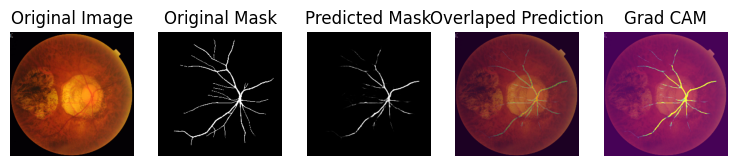

60/60 [==============================] - 18s 305ms/step - loss: 0.2354 - dice_coef: 0.8353 - accuracy: 0.9717 - val_loss: 0.3122 - val_dice_coef: 0.7851 - val_accuracy: 0.9680


In [17]:
checkpoint = ModelCheckpoint(
    'model_densnet_final.h5',
    monitor='val_accuracy',
    custom_objects={'ConvBlock': ConvBlock},
    verbose=0,
    save_best_only=True,
    save_weights_only=False,
    mode='auto',
)
class ShowProgress(Callback):
    def on_epoch_end(self, epoch, logs=None):
        if (epoch+1)%10==0:
            show_images(val_dataset, model=self.model, explain=True, n_images=3, SIZE=(15,8))

history = model.fit(
    train_dataset,
    validation_data=val_dataset,
    callbacks=[checkpoint,  ShowProgress()],
    use_multiprocessing=False,
    workers=1,
    epochs=100
)

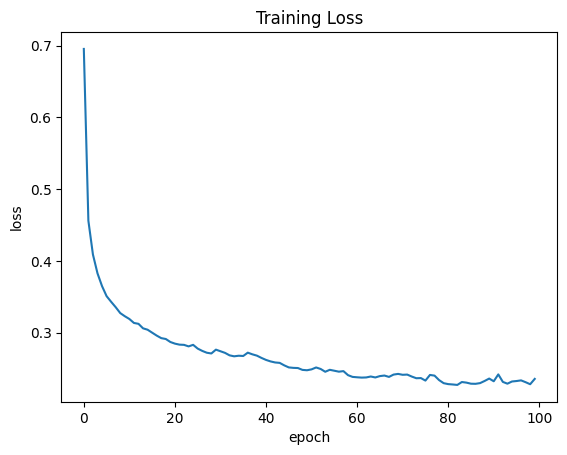

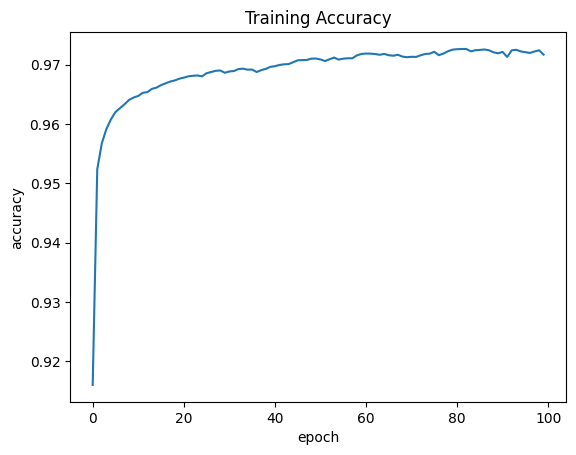

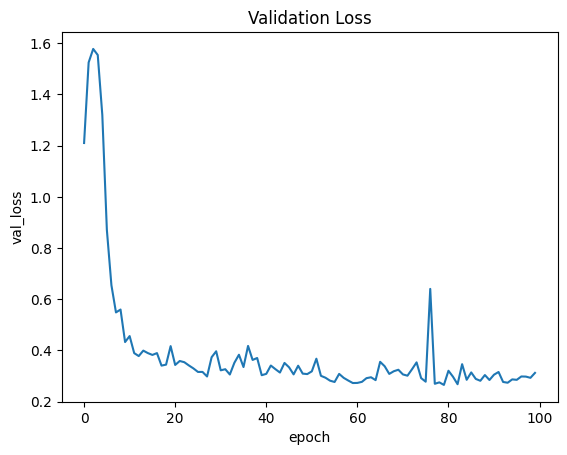

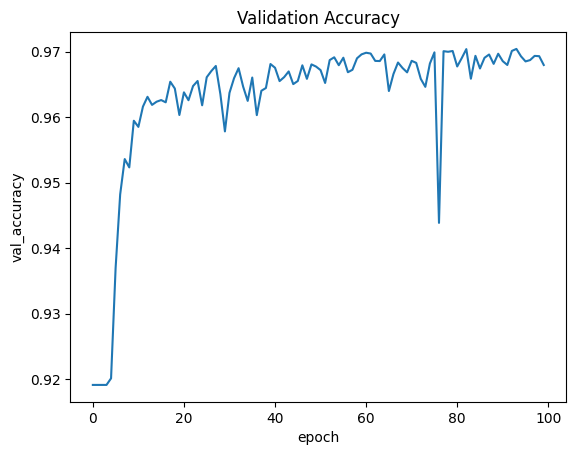

In [18]:
plt.plot(history.history["loss"])
plt.title("Training Loss")
plt.ylabel("loss")
plt.xlabel("epoch")
plt.show()

plt.plot(history.history["accuracy"])
plt.title("Training Accuracy")
plt.ylabel("accuracy")
plt.xlabel("epoch")
plt.show()

plt.plot(history.history["val_loss"])
plt.title("Validation Loss")
plt.ylabel("val_loss")
plt.xlabel("epoch")
plt.show()

plt.plot(history.history["val_accuracy"])
plt.title("Validation Accuracy")
plt.ylabel("val_accuracy")
plt.xlabel("epoch")
plt.show()

In [19]:
import tensorflow as tf

IMAGE_SIZE = 256
BATCH_SIZE = 8


def read_image(image_path, mask=False):
    image = tf.io.read_file(image_path)

    if mask:
        image = tf.image.decode_png(image, channels=1)
        image = tf.cast(image, tf.float32) / 255.0  # Normalize to [0, 1] for mask images
        image = tf.where(image >= 0.5, 1.0, 0.0)
        image = tf.image.resize(image, [IMAGE_SIZE, IMAGE_SIZE])
    else:
        image = tf.image.decode_png(image, channels=3)
        image = tf.cast(image, tf.float32) / 255.0  # Normalize to [0, 1] for RGB images

        image = tf.image.resize(image, [IMAGE_SIZE, IMAGE_SIZE])

    return image

def load_data(image_list, mask_list):
    image = read_image(image_list)
    mask = read_image(mask_list, mask=True)
    return image, mask

def data_generator(image_list, mask_list):
    dataset = tf.data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    return dataset

test_dataset = data_generator(test_image_paths, test_mask_paths)

print("Test Dataset:", test_dataset)



Test Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(8, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(8, 256, 256, 1), dtype=tf.float32, name=None))>


In [20]:
m1 = keras.models.load_model("/content/model_densnet_final.h5", custom_objects={'dice_coef': dice_coef})
dice_score = m1.evaluate(val_dataset, verbose=0)
print("Val Dice Score:", dice_score[1])

Val Dice Score: 0.807622492313385


In [22]:
def calculate_metrics(model, test_dataset):
    accuracy_scores = []
    dice_scores = []
    tp_scores = []
    tn_scores = []
    fp_scores = []
    fn_scores = []

    for image, mask in test_dataset:

        pred_mask = model.predict(image)


        mask = mask.numpy()

        pred_mask_binary = (pred_mask > 0.5).astype(np.float32)

        mask_flat = mask.flatten()
        pred_mask_flat = pred_mask_binary.flatten()

        # Calculate True Positives, True Negatives, False Positives, and False Negatives
        tp = np.sum(mask_flat * pred_mask_flat)
        tn = np.sum((1 - mask_flat) * (1 - pred_mask_flat))
        fp = np.sum((1 - mask_flat) * pred_mask_flat)
        fn = np.sum(mask_flat * (1 - pred_mask_flat))

        # Calculate accuracy, Dice score
        accuracy = (tp + tn) / (tp + tn + fp + fn)
        dice = (2.0 * tp) / (2.0 * tp + fp + fn)

        accuracy_scores.append(accuracy)
        dice_scores.append(dice)
        tp_scores.append(tp)
        tn_scores.append(tn)
        fp_scores.append(fp)
        fn_scores.append(fn)

    # Calculate and print average accuracy and Dice scores
    avg_accuracy = np.mean(accuracy_scores)
    avg_dice = np.mean(dice_scores)

    print(f"Average Accuracy: {avg_accuracy:.4f}")
    print(f"Average Dice Score: {avg_dice:.4f}")

    TP = np.mean(tp_scores)
    TN = np.mean(tn_scores)
    FP = np.mean(fp_scores)
    FN = np.mean(fn_scores)

    f1 = 2 * TP / (2 * TP + FP + FN)
    recall = TP/(FN+TP)
    precision = TP/(TP+FP)
    specificity = TN/(FP+TN)
    MCC = (TP*TN - FP*FN)/ np.sqrt((TP+FP)*(TP+FN)*(TN+FP)*(TN+FN))

    print("Precision Score:", precision)
    print("Sensitivity/Recall Score:", recall)
    print("Specificity Score:", specificity)
    print("F1 Score:", f1)
    print("MCC :", MCC)

calculate_metrics(m1, test_dataset)


1/1 [==============================] - 0s 31ms/step
Average Accuracy: 0.9755
Average Dice Score: 0.8186
Precision Score: 0.8671715
Sensitivity/Recall Score: 0.7752507
Specificity Score: 0.99089736
F1 Score: 0.8186388605634701
MCC : 0.8070247


1/1 [==============================] - 0s 80ms/step


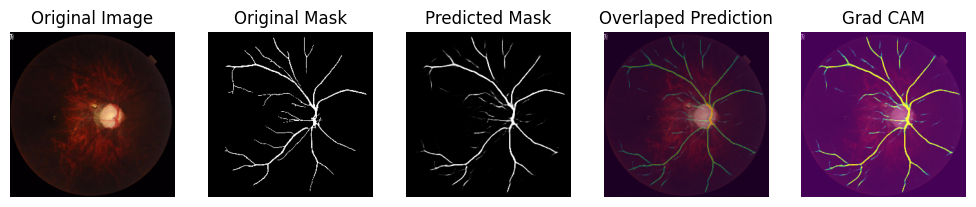

1/1 [==============================] - 0s 72ms/step


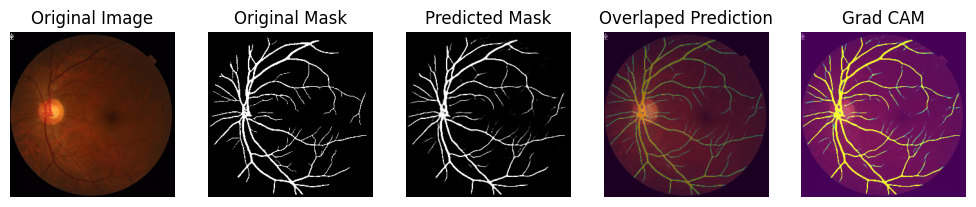

1/1 [==============================] - 0s 57ms/step


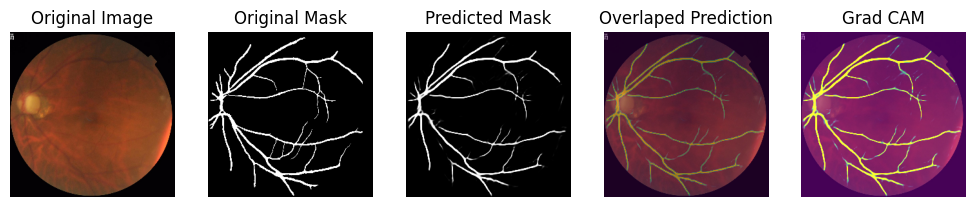

1/1 [==============================] - 0s 71ms/step


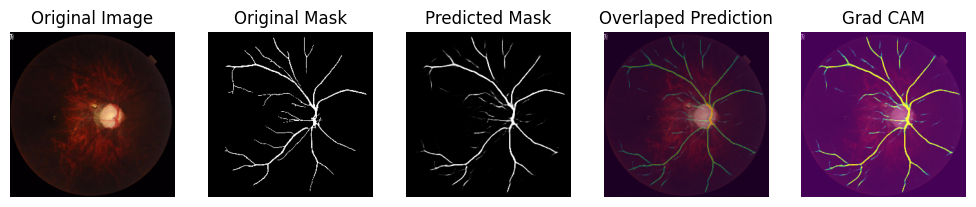

1/1 [==============================] - 0s 70ms/step


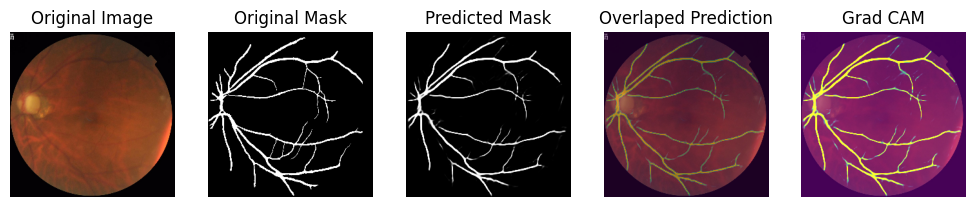

1/1 [==============================] - 0s 87ms/step


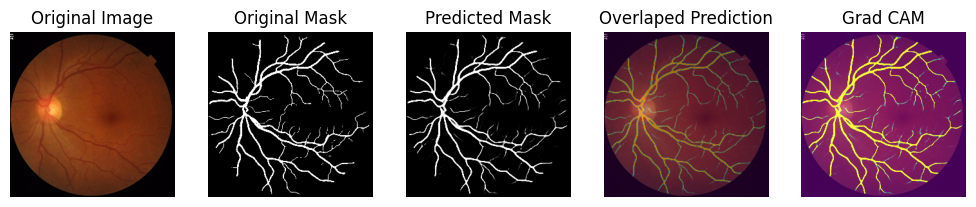

1/1 [==============================] - 0s 84ms/step


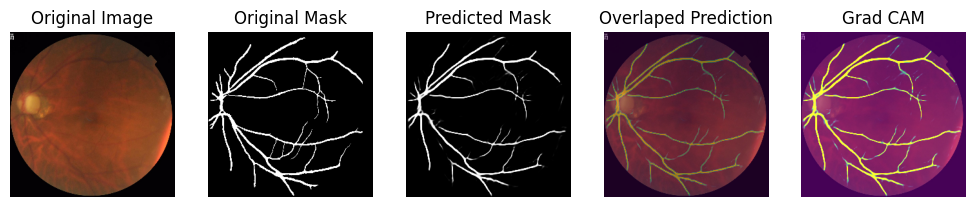

1/1 [==============================] - 0s 81ms/step


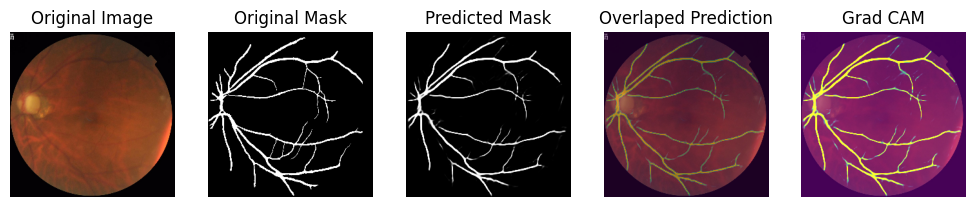

1/1 [==============================] - 0s 77ms/step


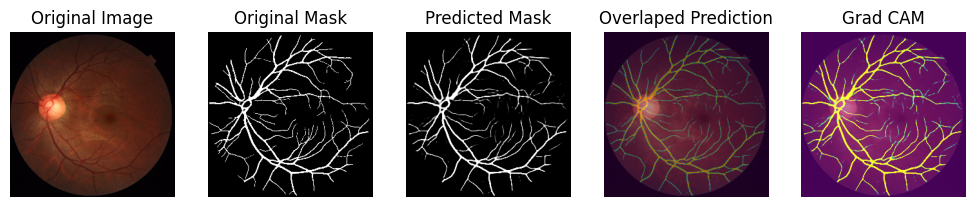

1/1 [==============================] - 0s 74ms/step


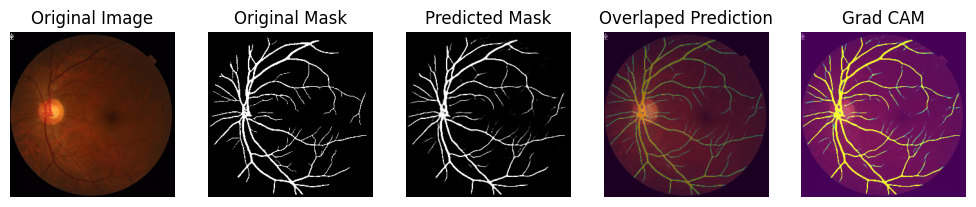

In [23]:
show_images(test_dataset, model=m1, explain=True, n_images=10, SIZE=(20,8))

1/1 [==============================] - 0s 72ms/step


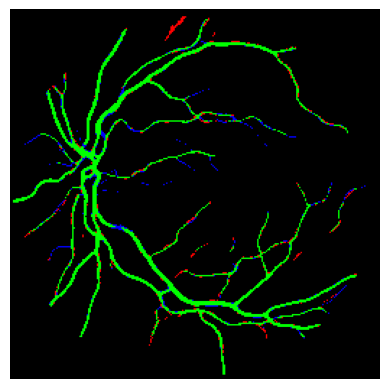

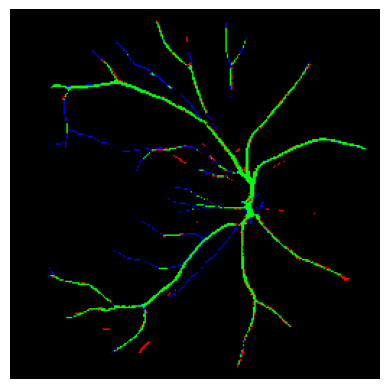

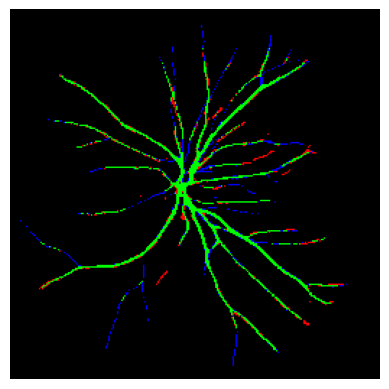

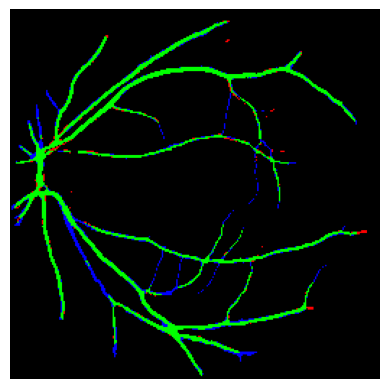

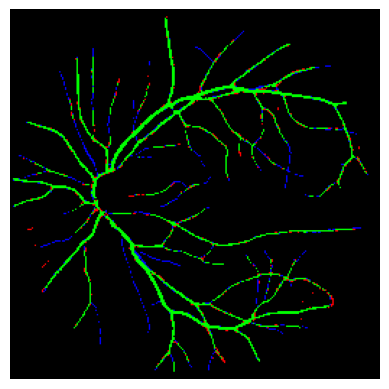

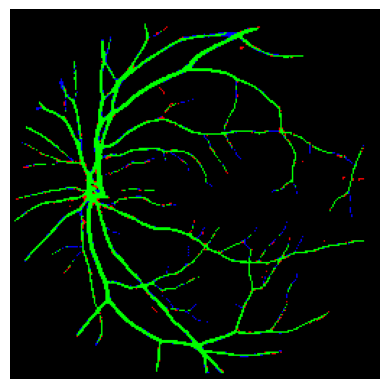

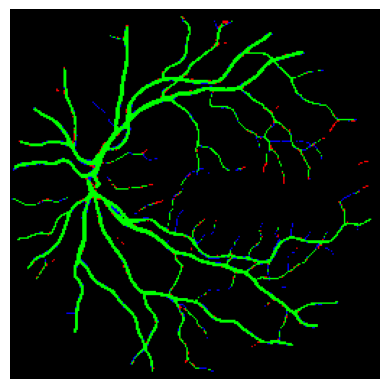

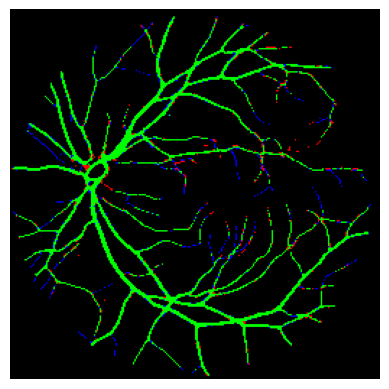

1/1 [==============================] - 0s 50ms/step


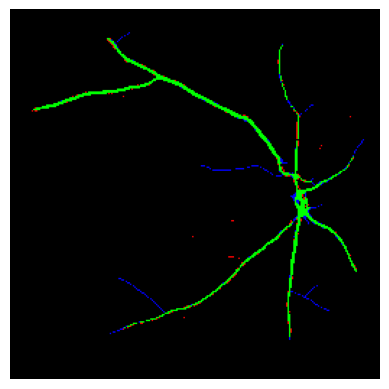

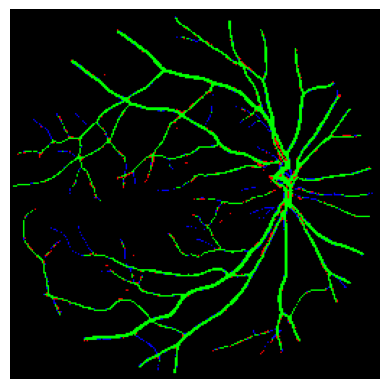

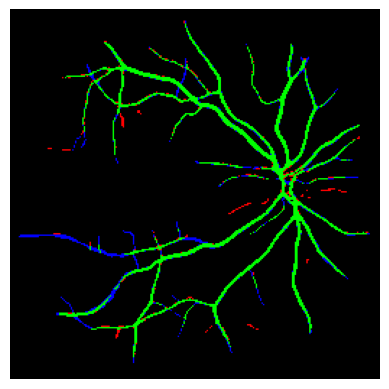

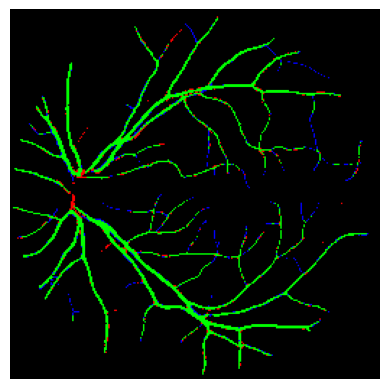

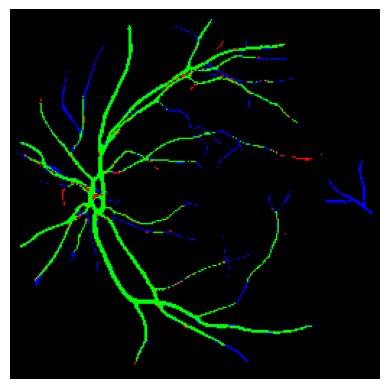

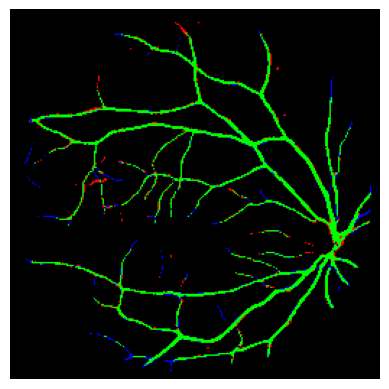

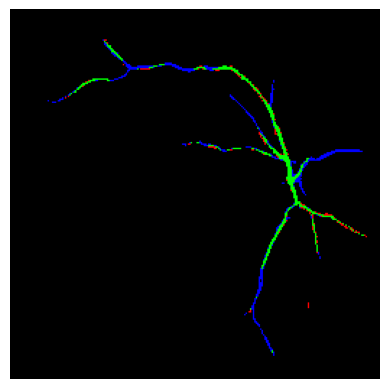

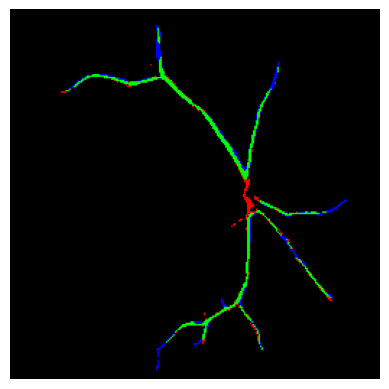

1/1 [==============================] - 0s 52ms/step


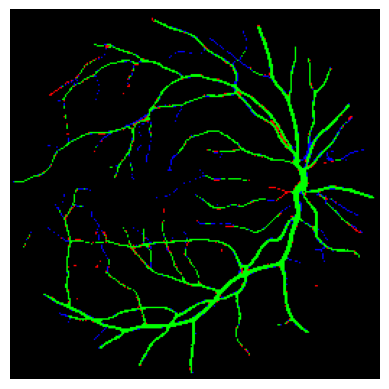

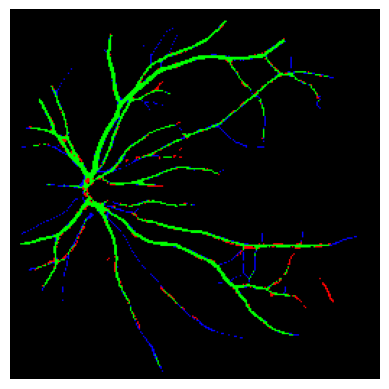

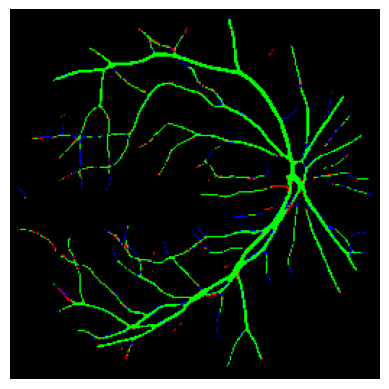

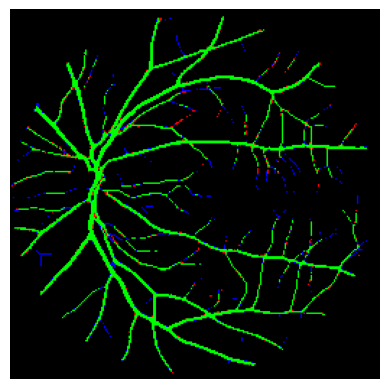

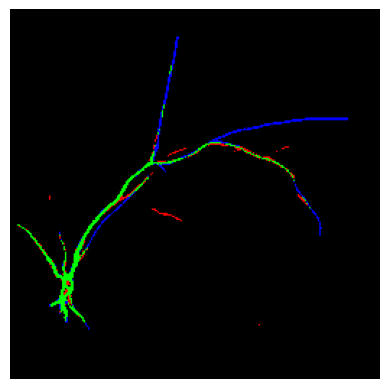

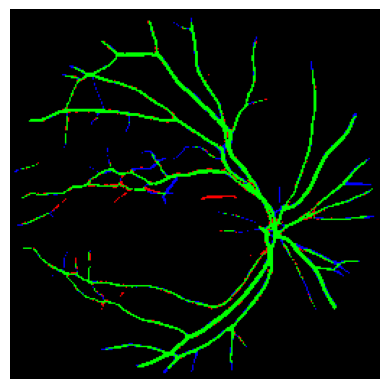

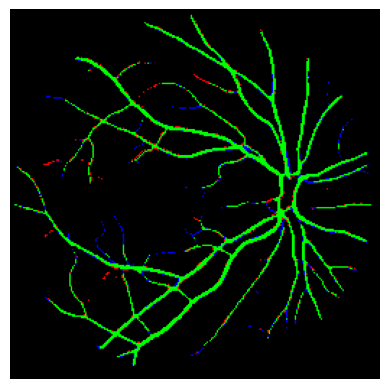

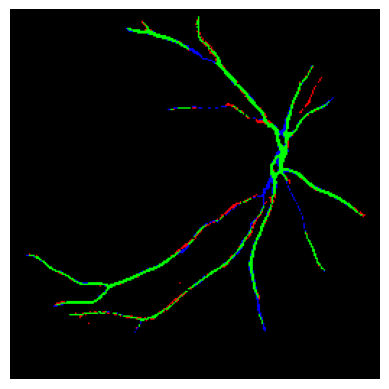

1/1 [==============================] - 0s 52ms/step


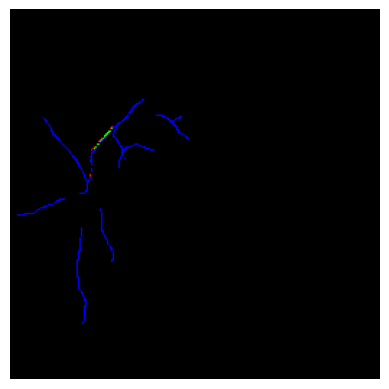

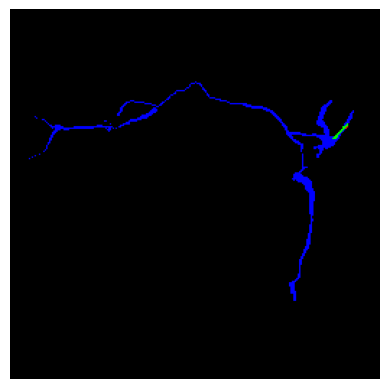

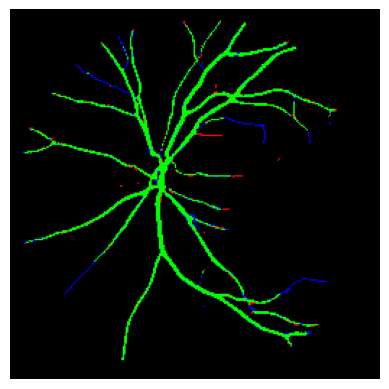

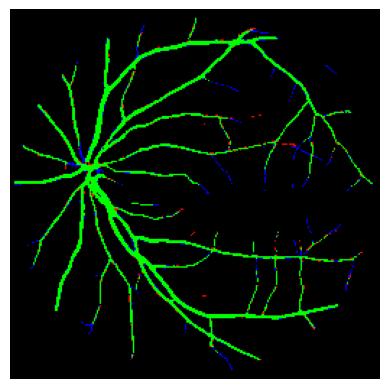

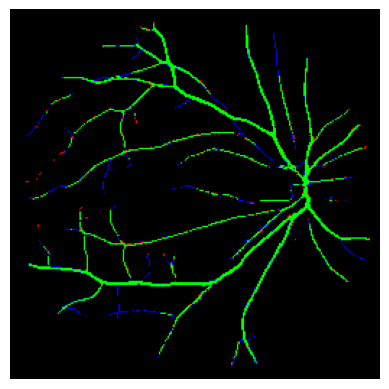

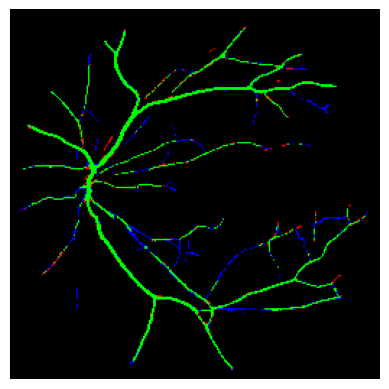

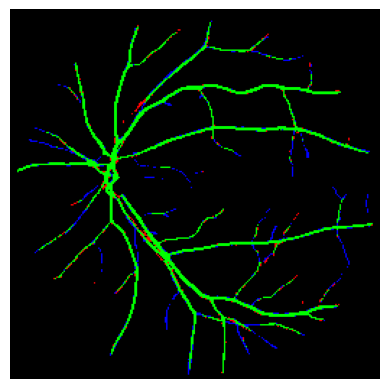

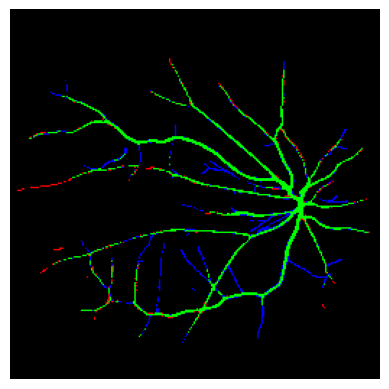

1/1 [==============================] - 0s 59ms/step


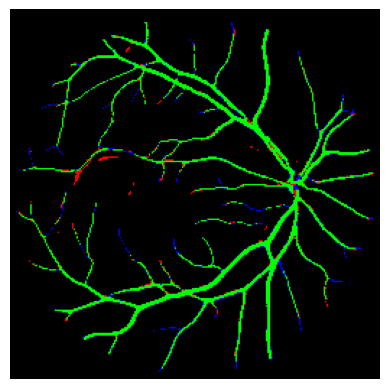

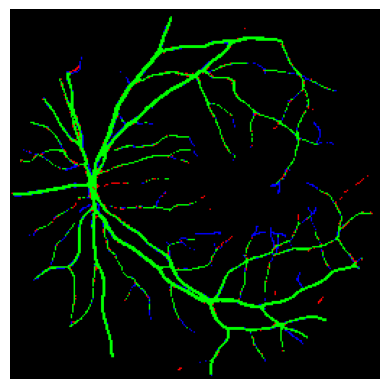

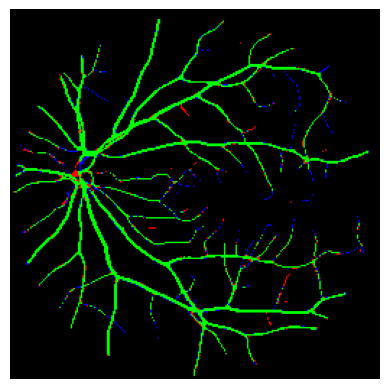

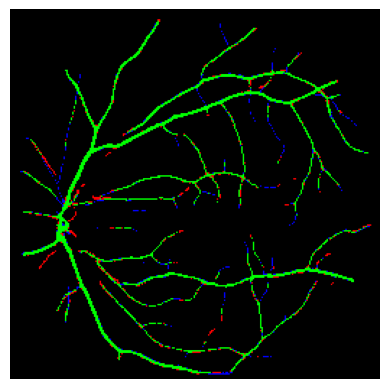

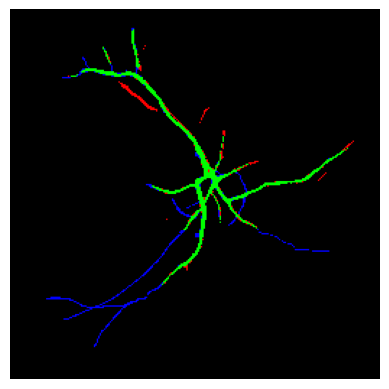

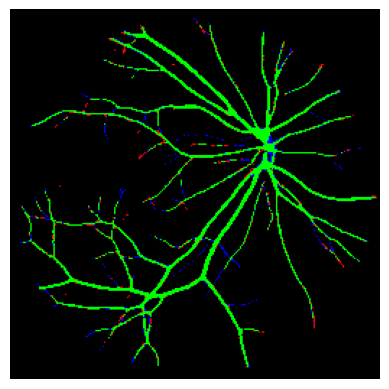

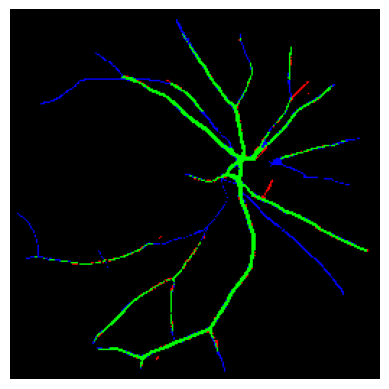

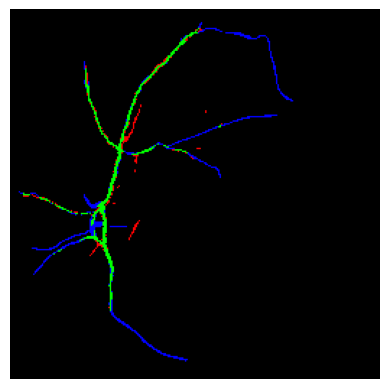

1/1 [==============================] - 0s 56ms/step


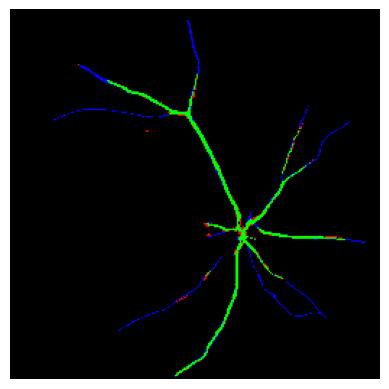

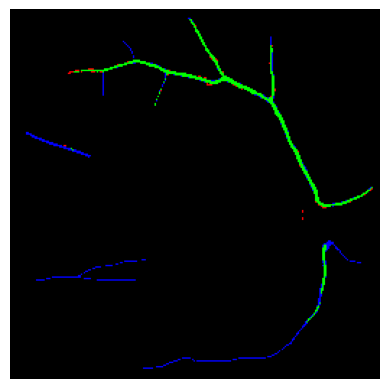

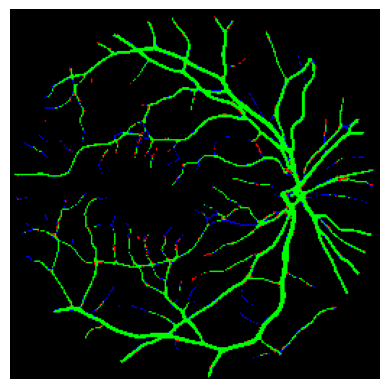

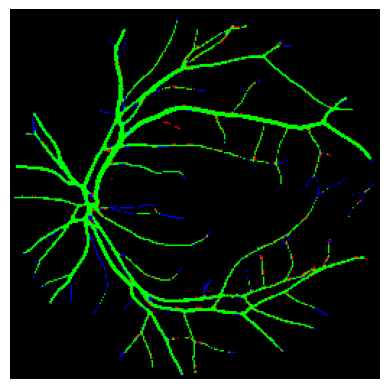

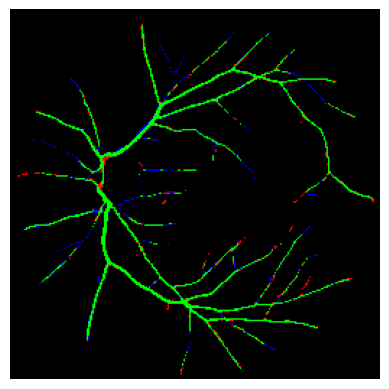

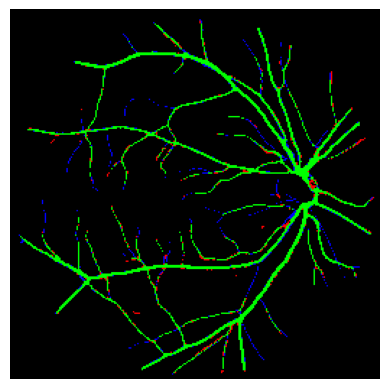

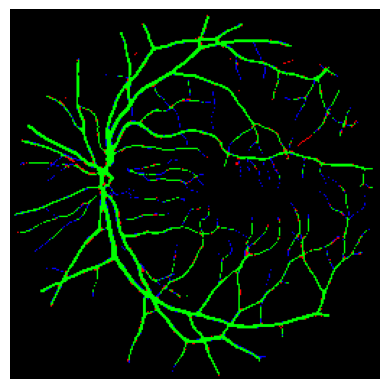

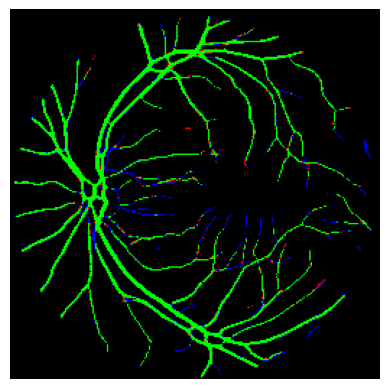

1/1 [==============================] - 0s 61ms/step


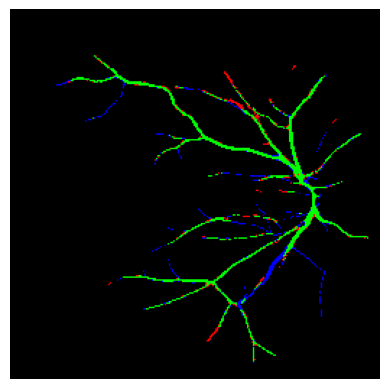

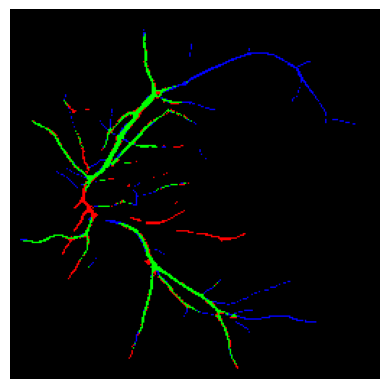

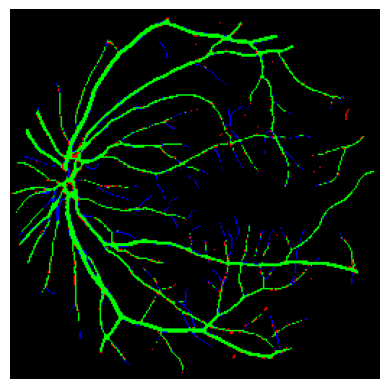

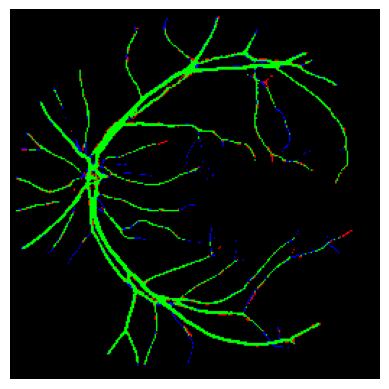

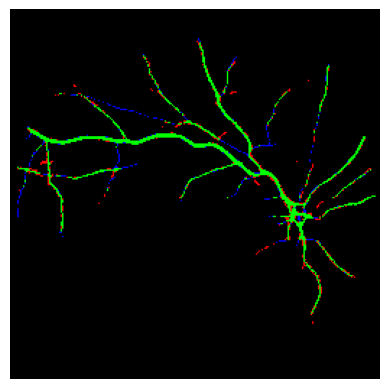

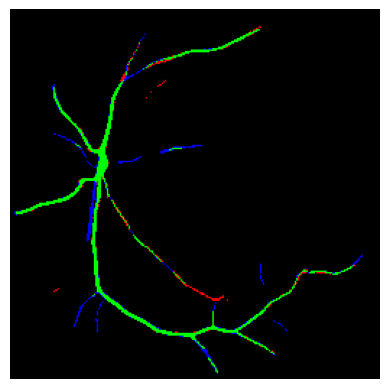

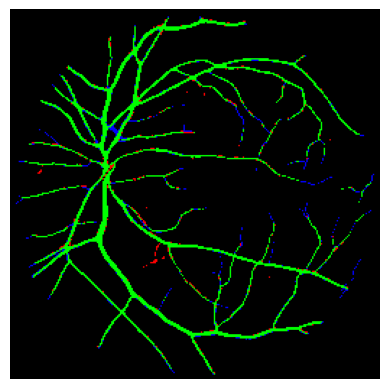

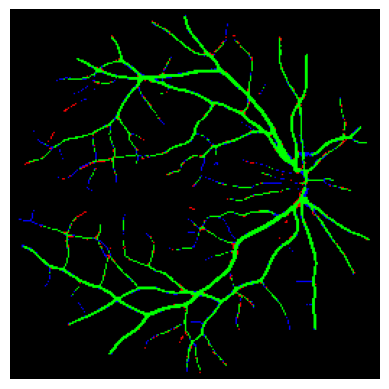

1/1 [==============================] - 0s 49ms/step


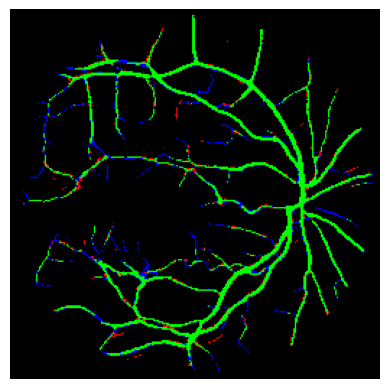

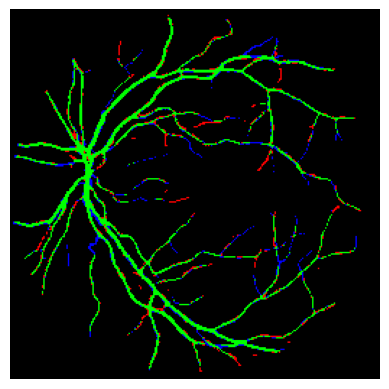

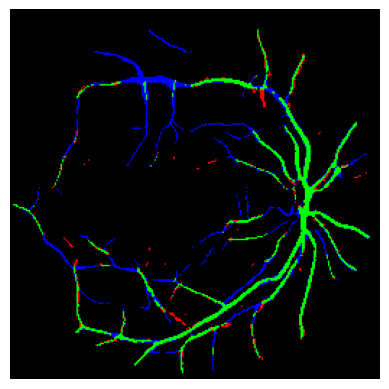

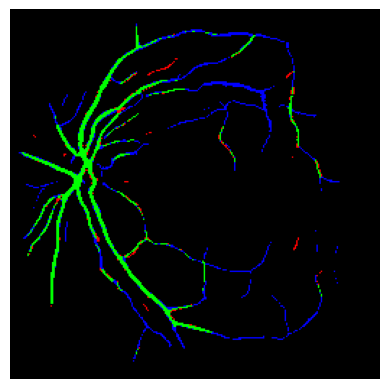

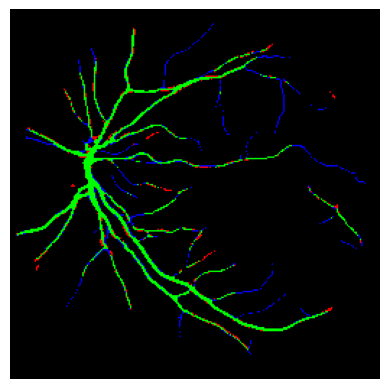

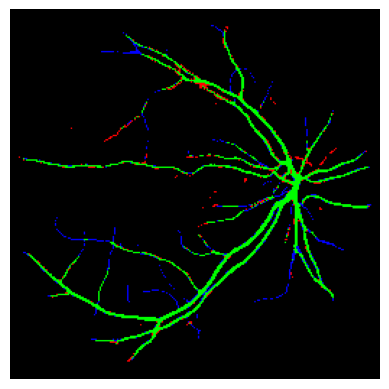

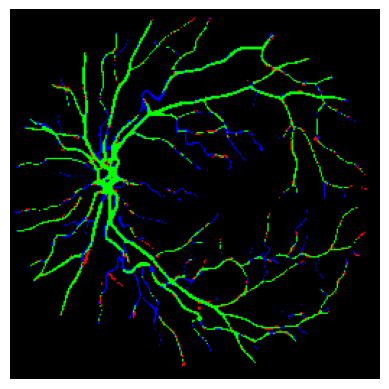

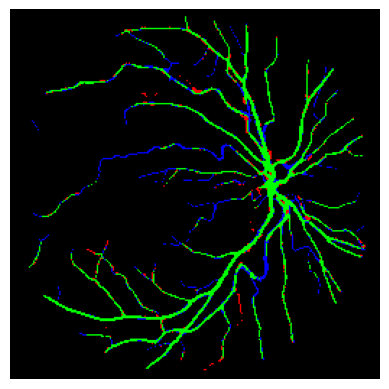

1/1 [==============================] - 0s 63ms/step


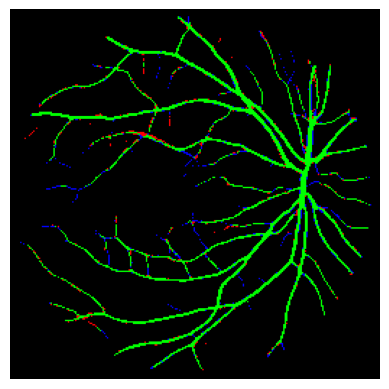

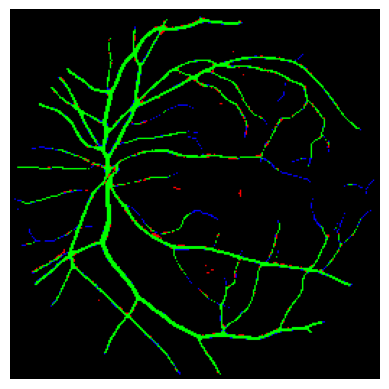

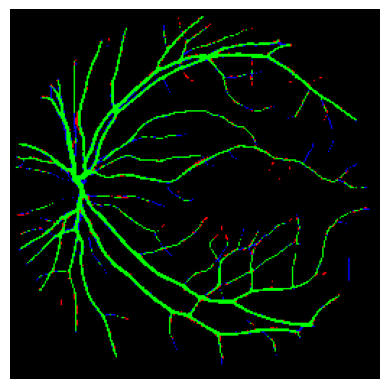

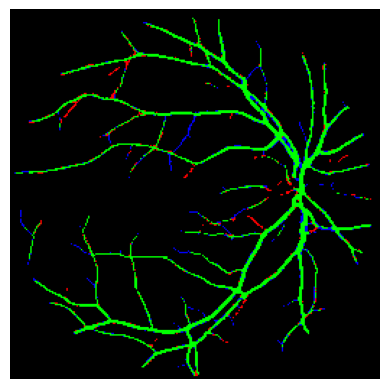

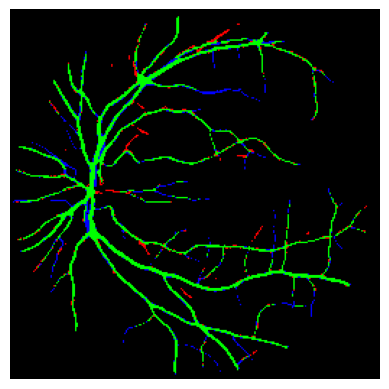

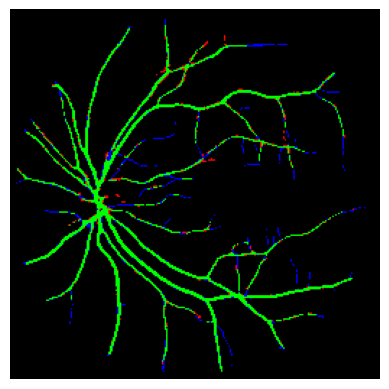

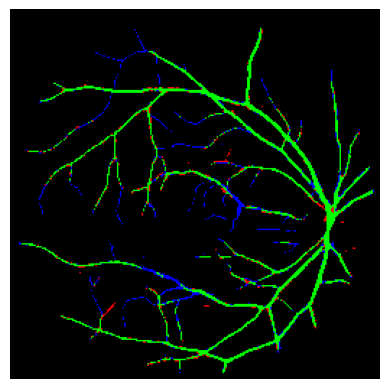

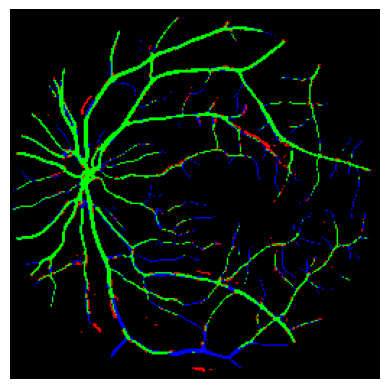

1/1 [==============================] - 0s 53ms/step


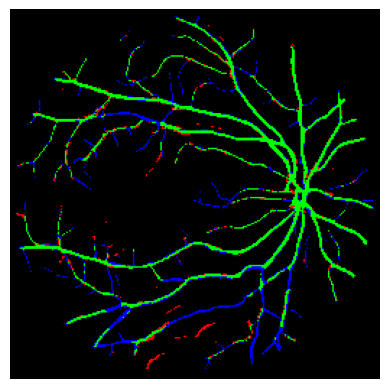

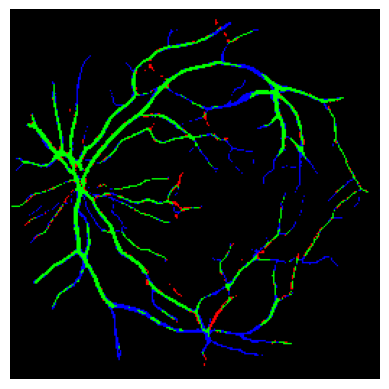

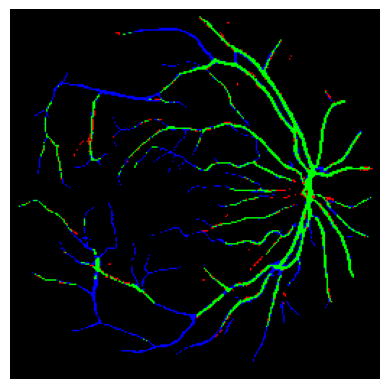

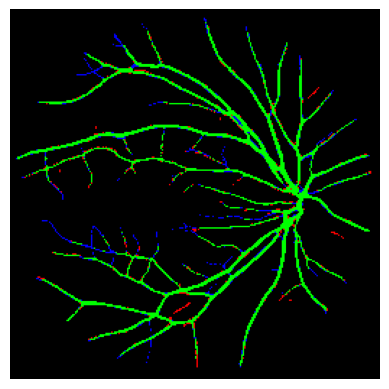

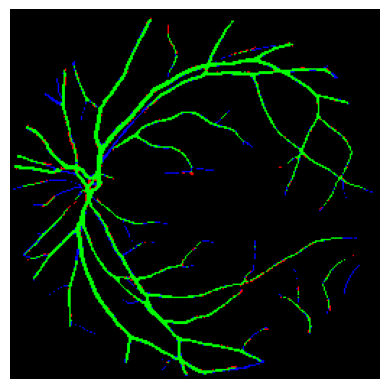

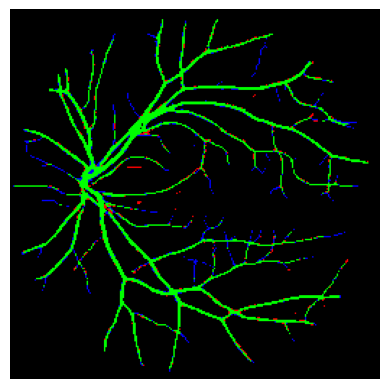

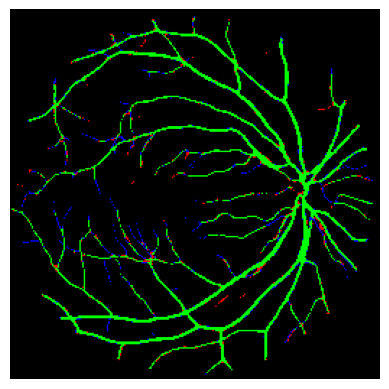

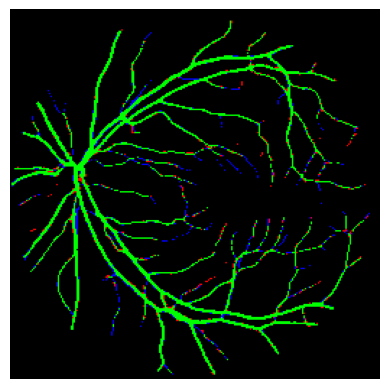

1/1 [==============================] - 0s 55ms/step


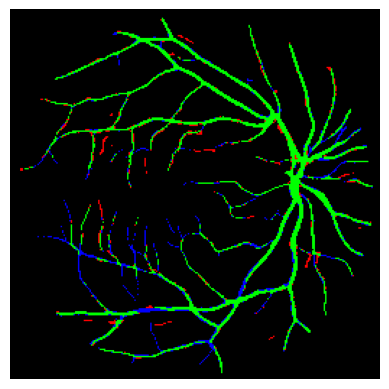

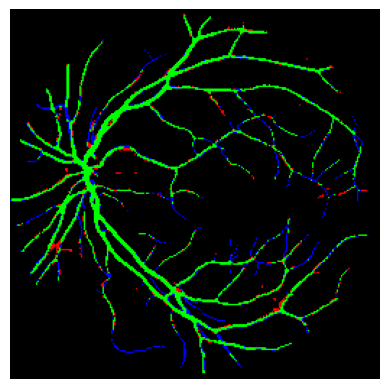

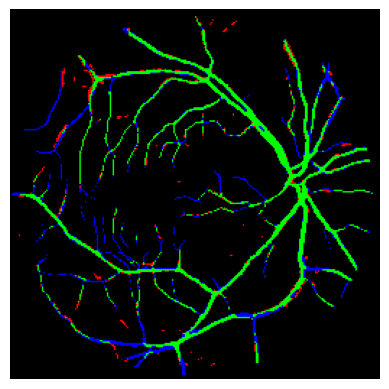

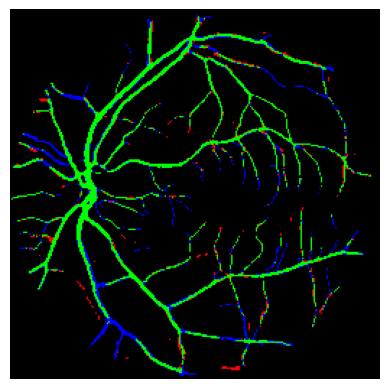

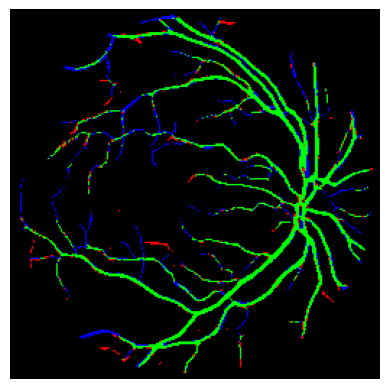

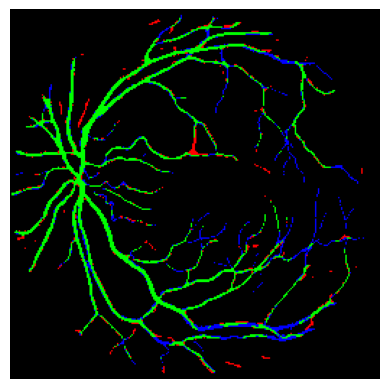

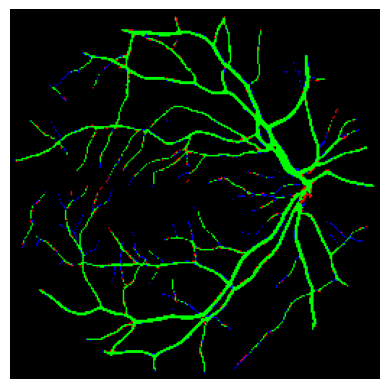

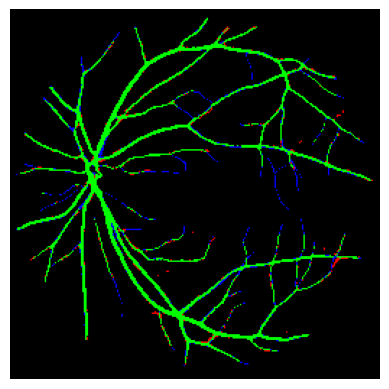

1/1 [==============================] - 0s 54ms/step


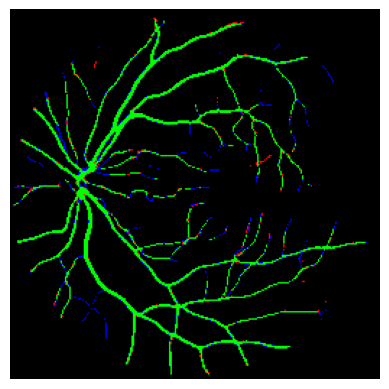

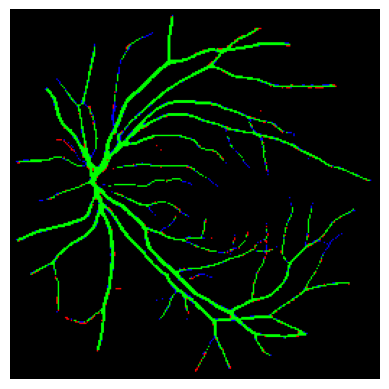

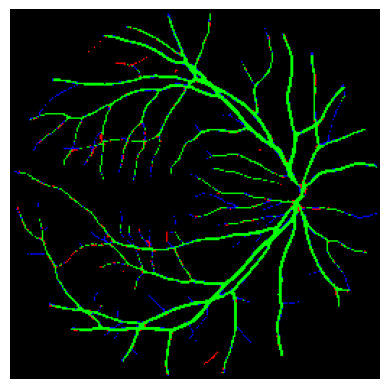

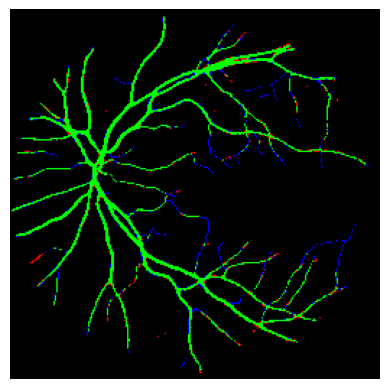

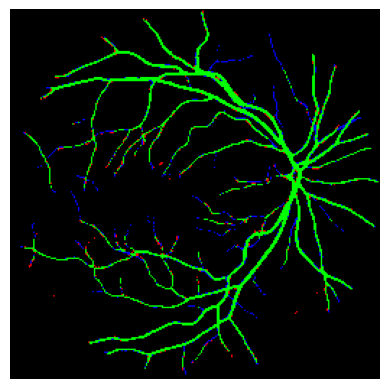

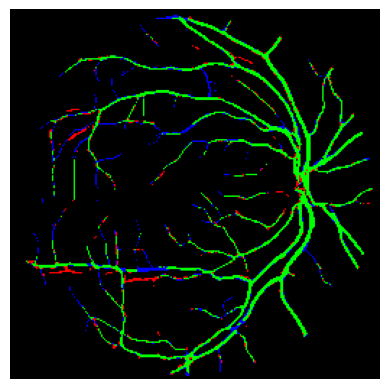

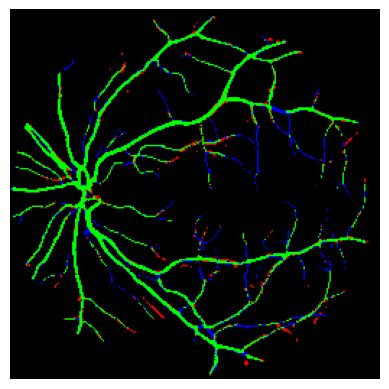

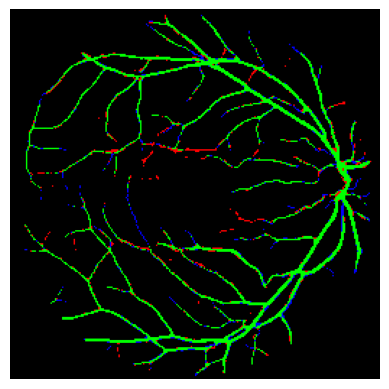

1/1 [==============================] - 0s 49ms/step


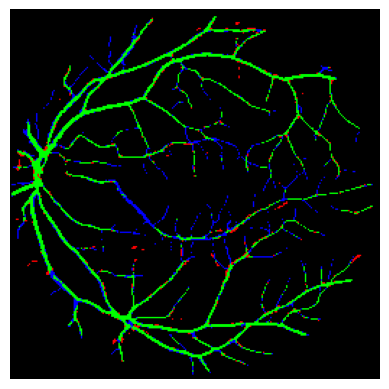

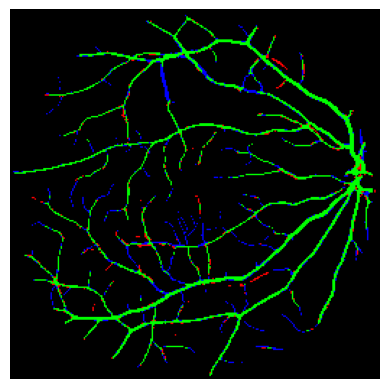

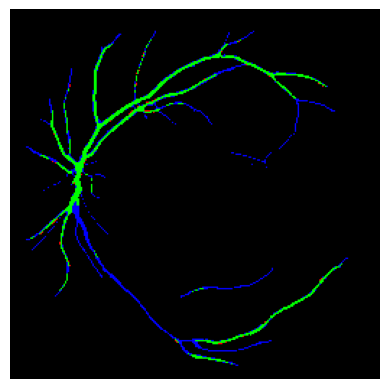

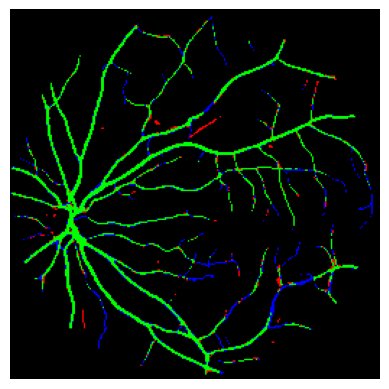

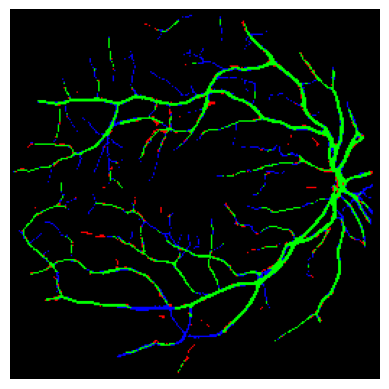

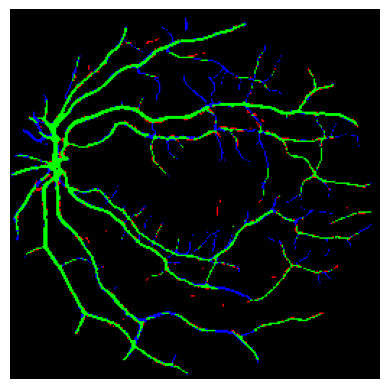

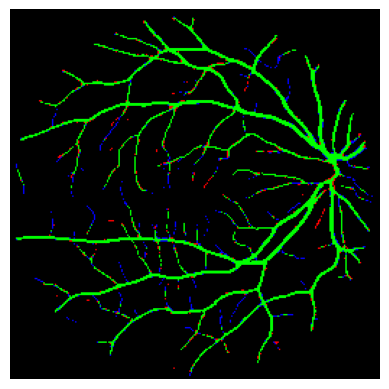

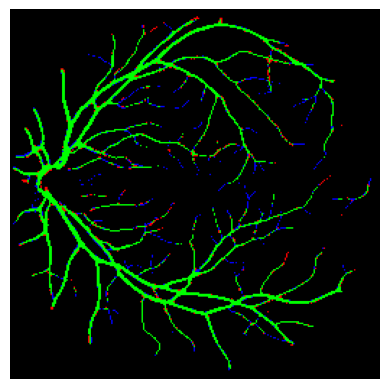

1/1 [==============================] - 0s 61ms/step


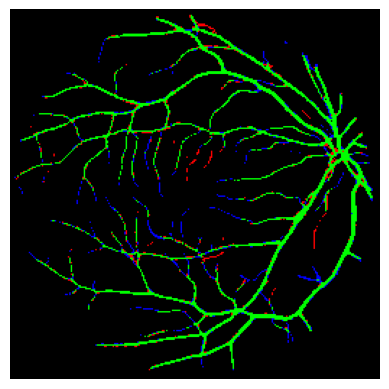

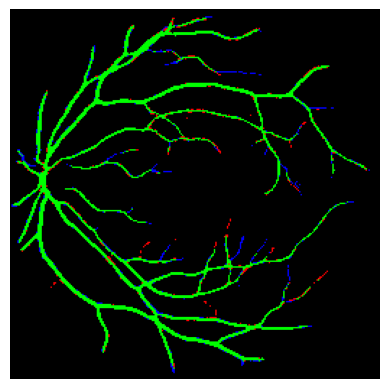

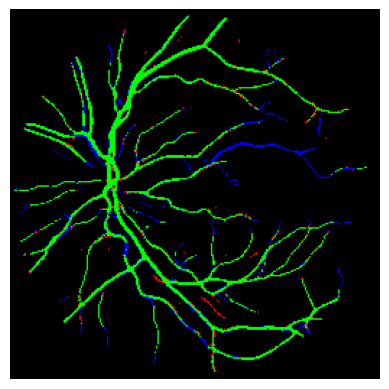

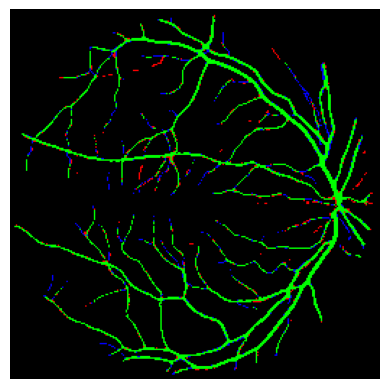

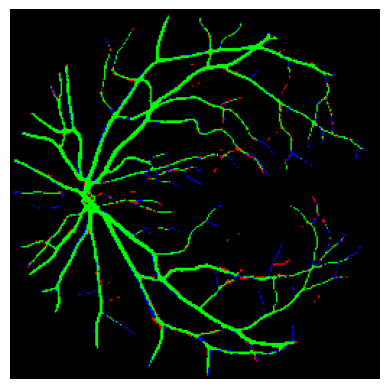

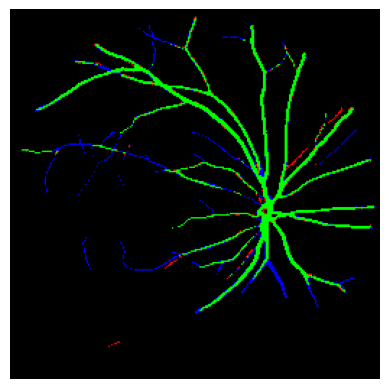

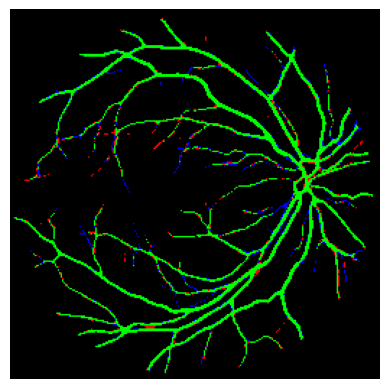

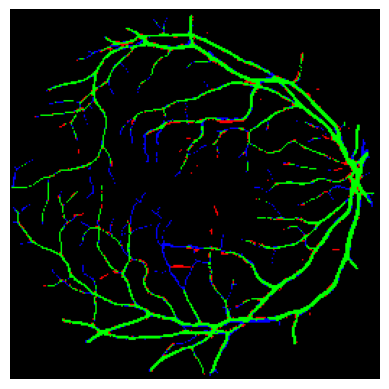

1/1 [==============================] - 0s 50ms/step


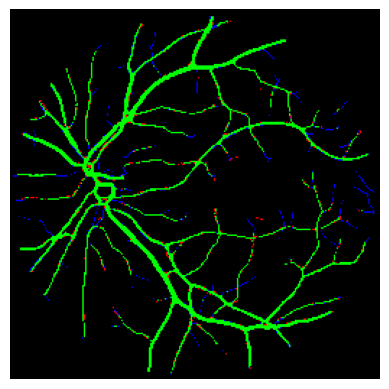

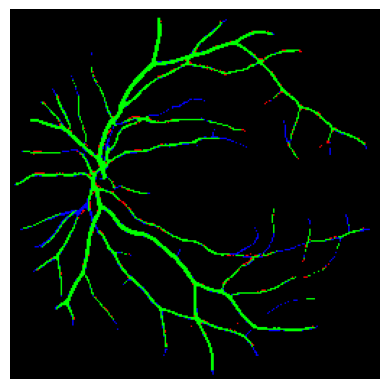

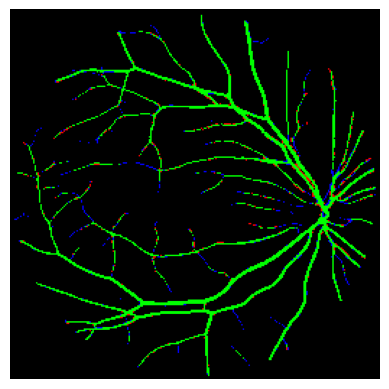

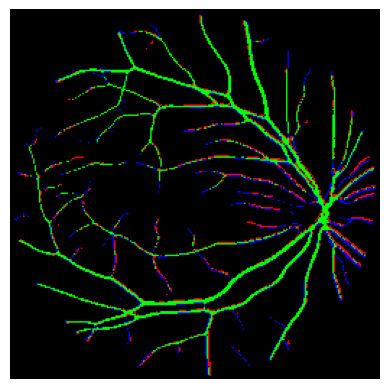

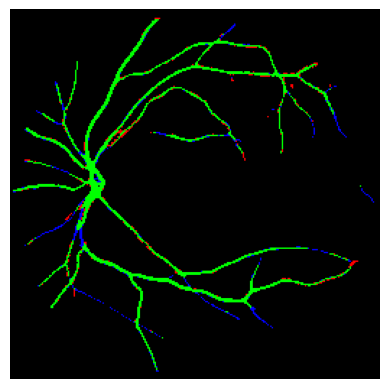

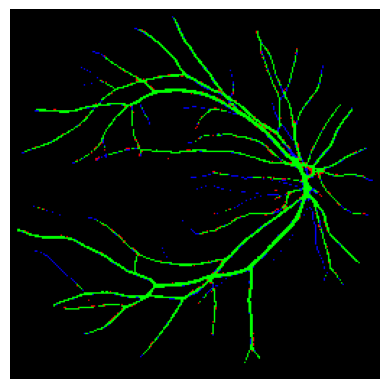

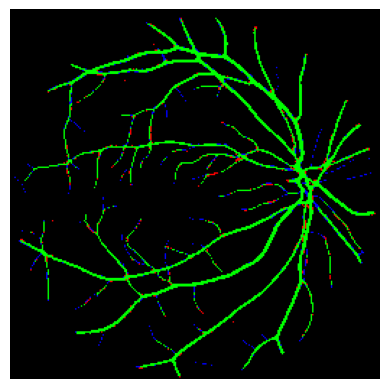

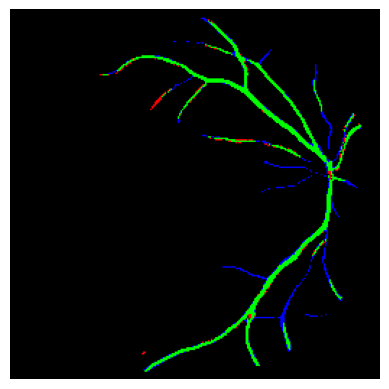

1/1 [==============================] - 0s 49ms/step


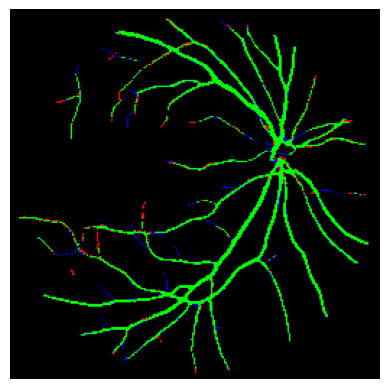

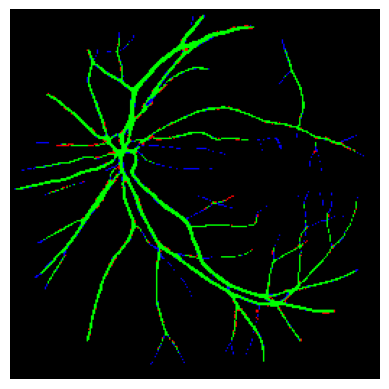

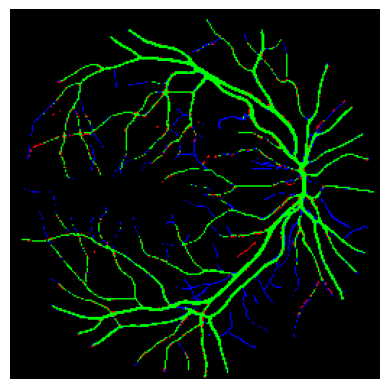

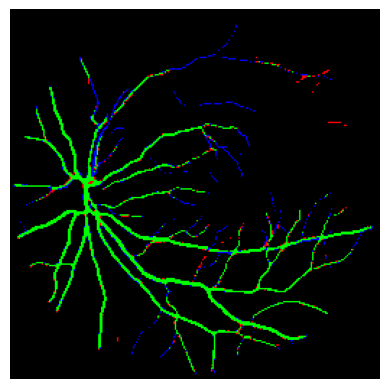

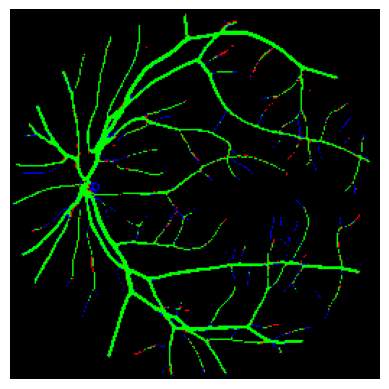

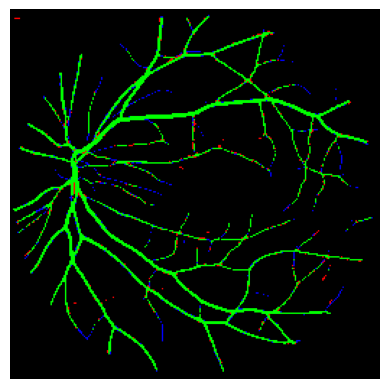

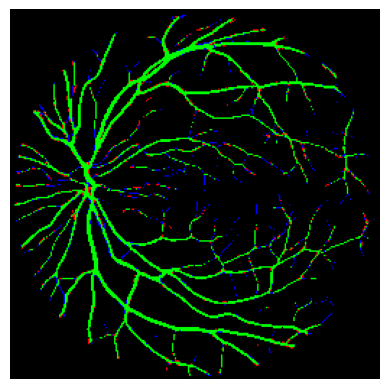

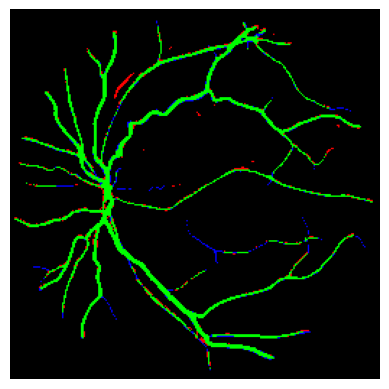

1/1 [==============================] - 0s 62ms/step


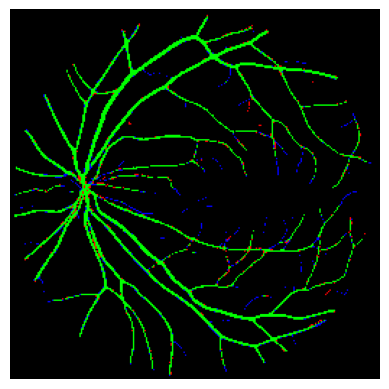

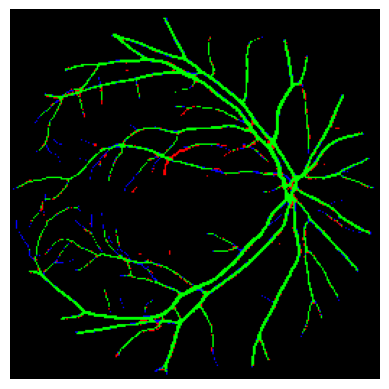

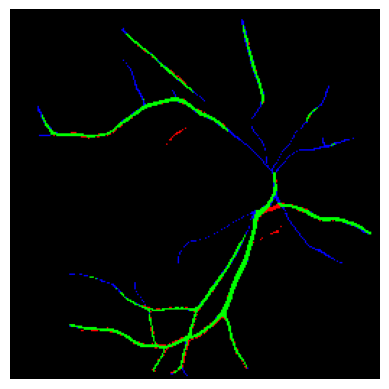

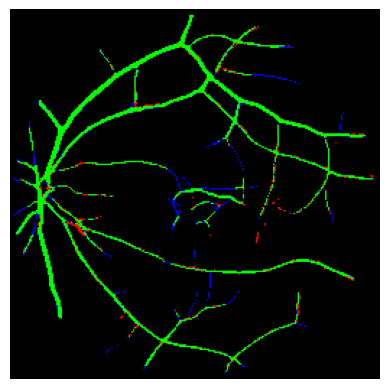

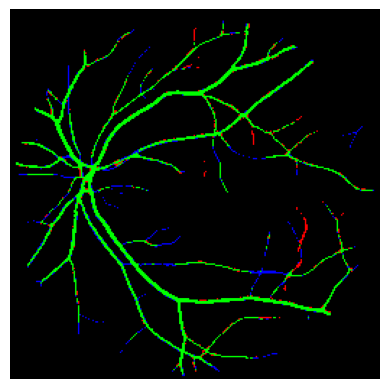

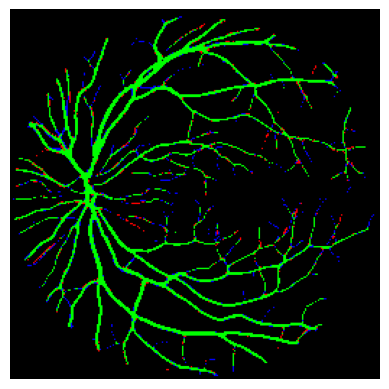

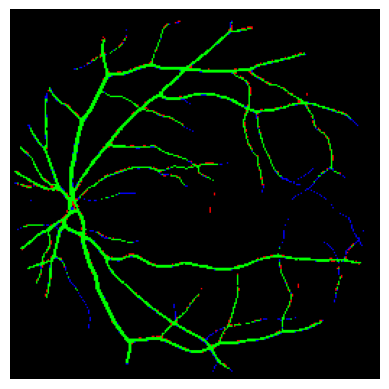

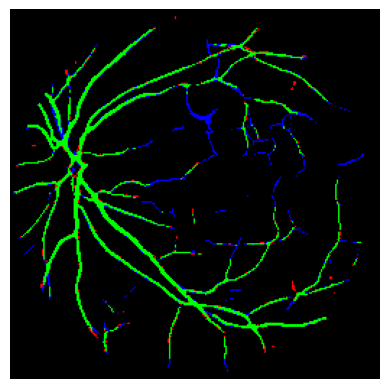

1/1 [==============================] - 0s 59ms/step


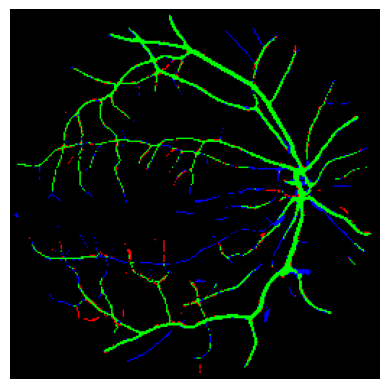

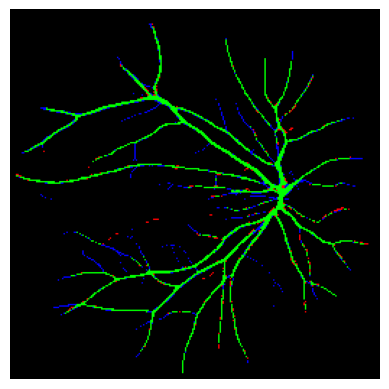

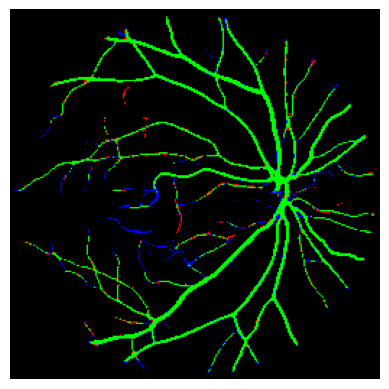

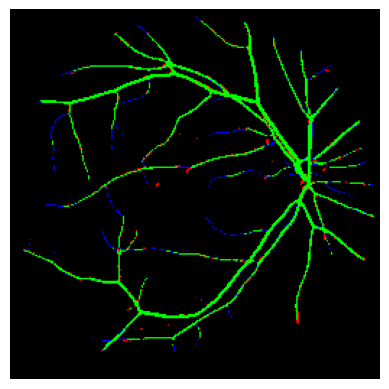

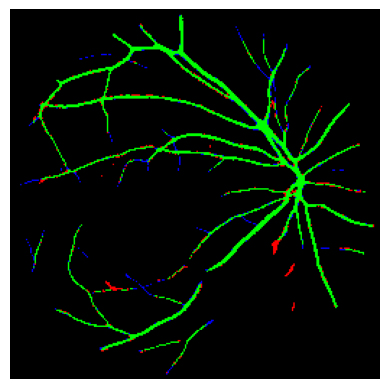

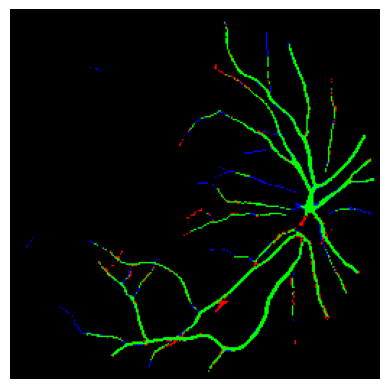

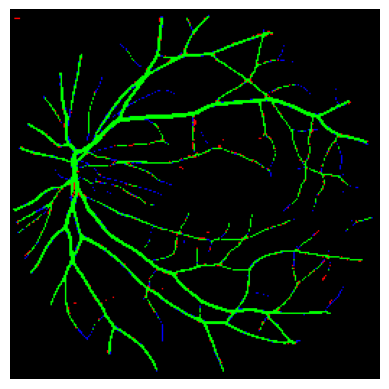

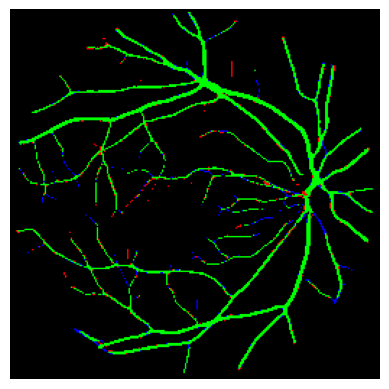

1/1 [==============================] - 0s 54ms/step


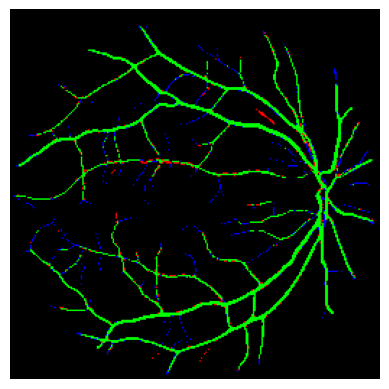

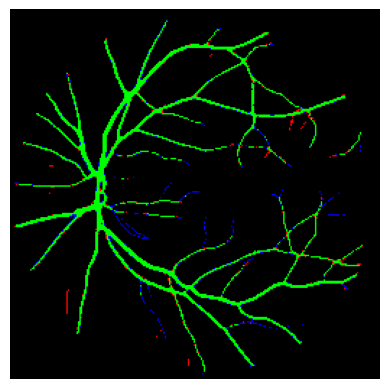

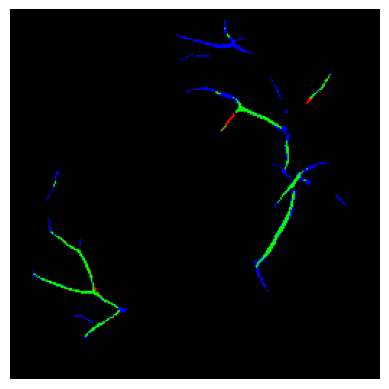

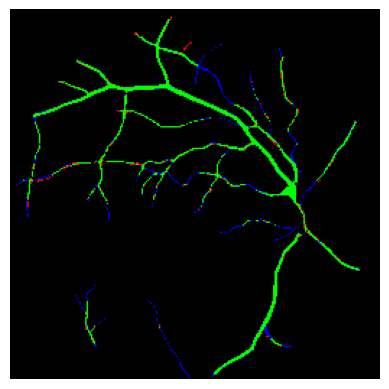

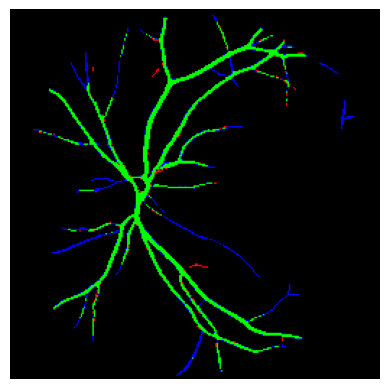

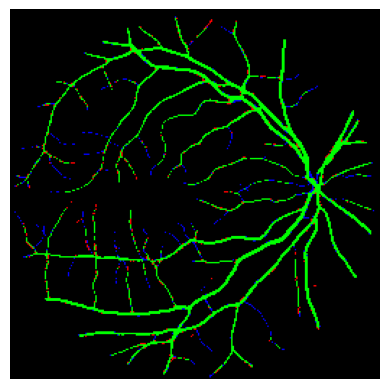

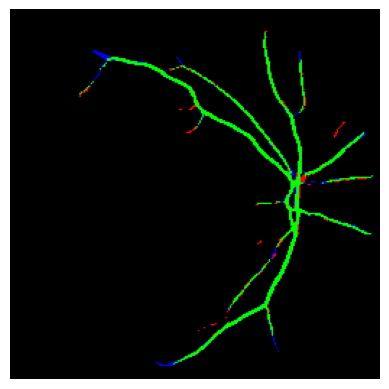

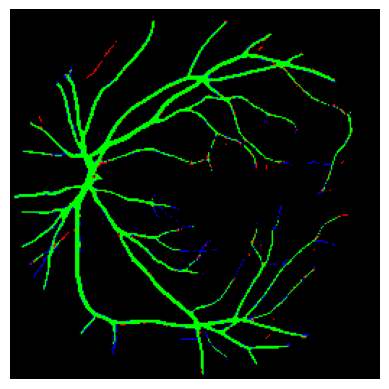

1/1 [==============================] - 0s 55ms/step


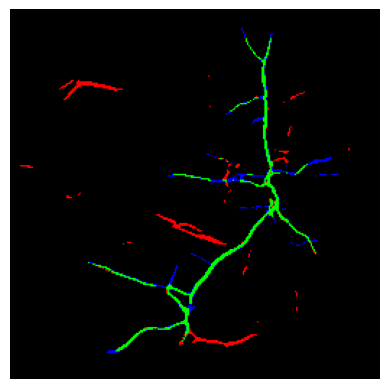

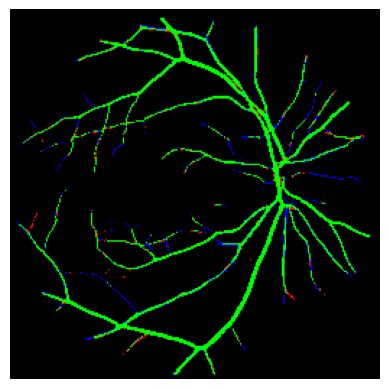

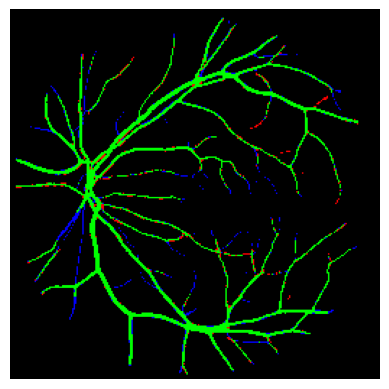

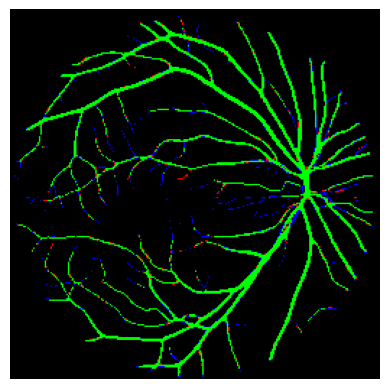

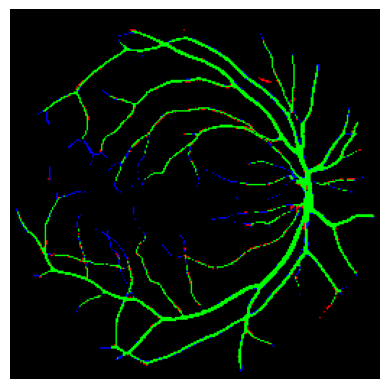

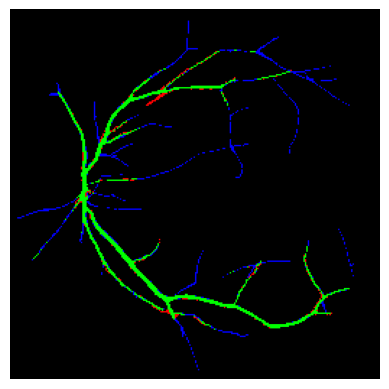

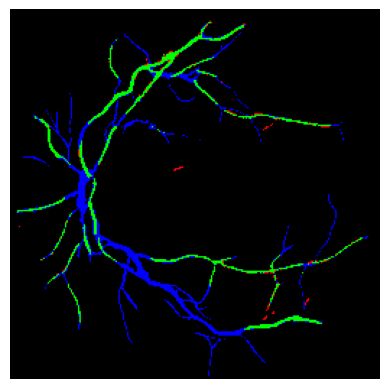

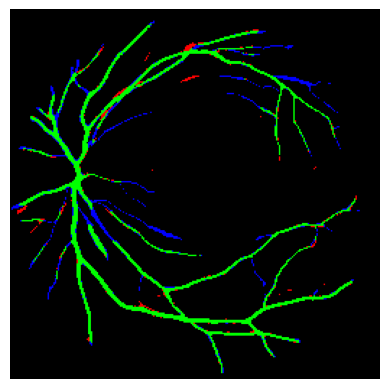

1/1 [==============================] - 0s 42ms/step


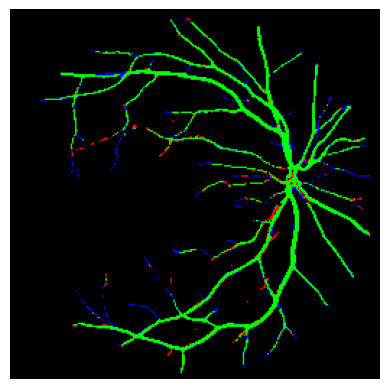

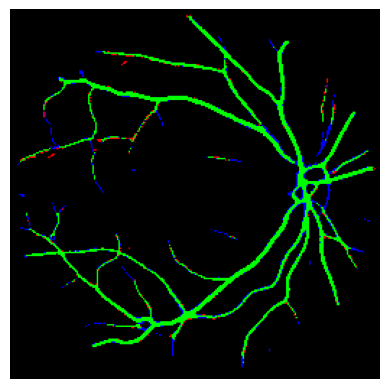

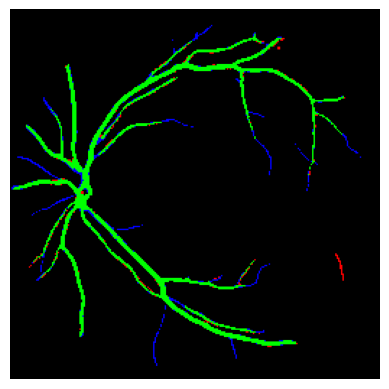

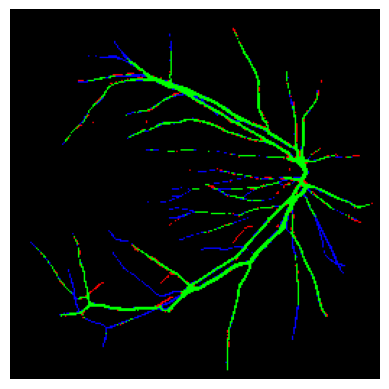

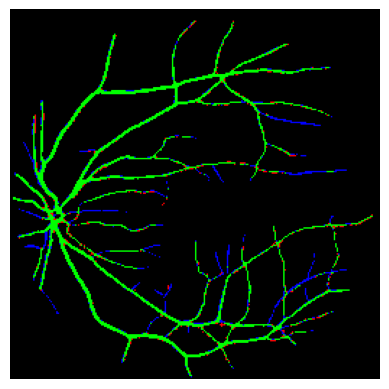

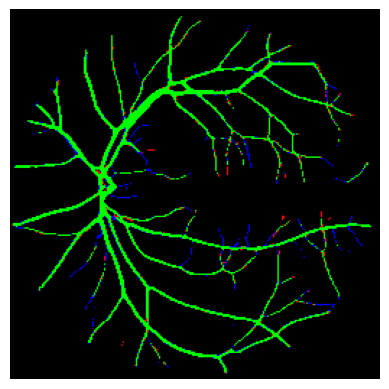

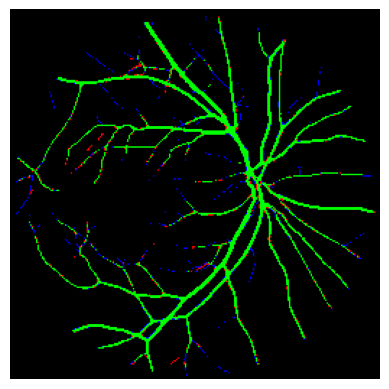

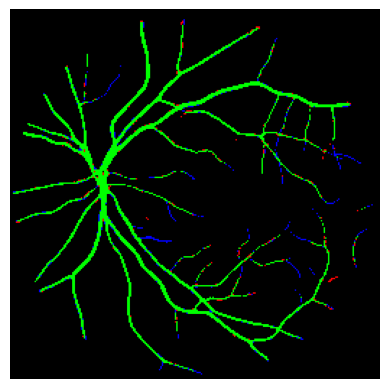

1/1 [==============================] - 0s 48ms/step


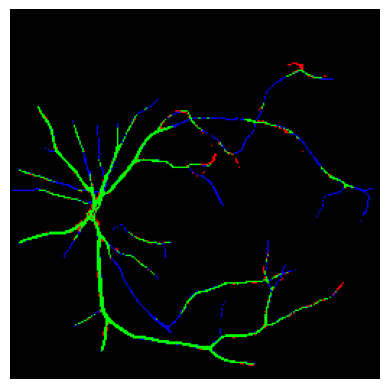

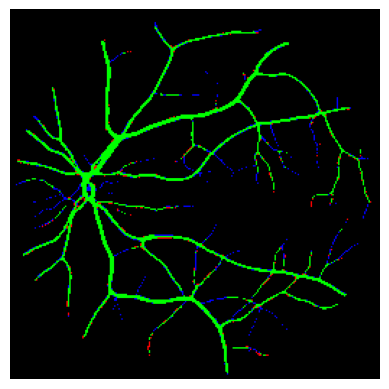

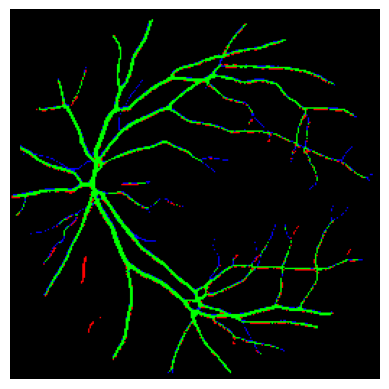

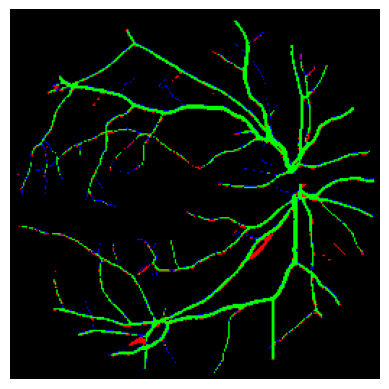

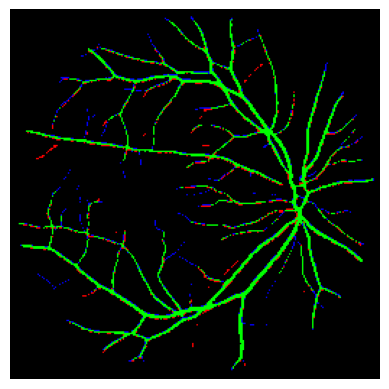

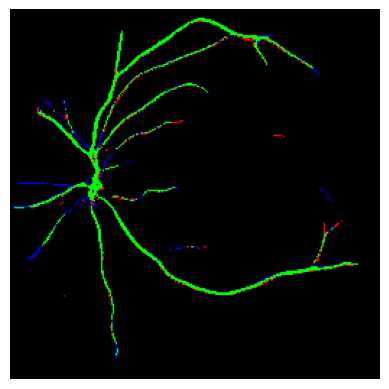

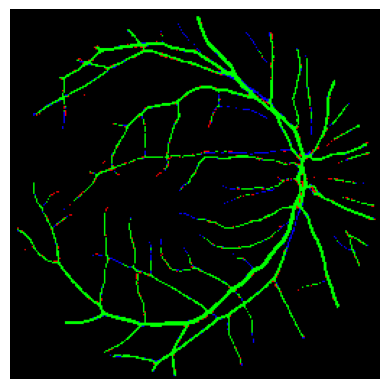

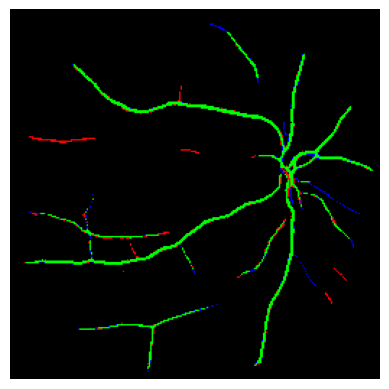

1/1 [==============================] - 0s 31ms/step


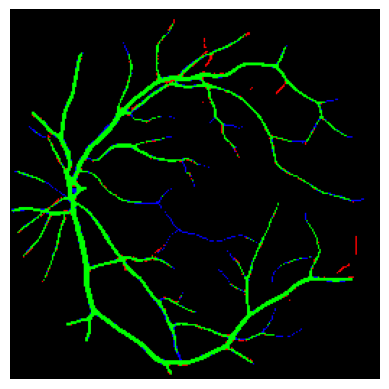

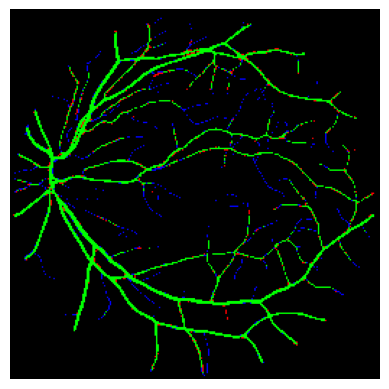

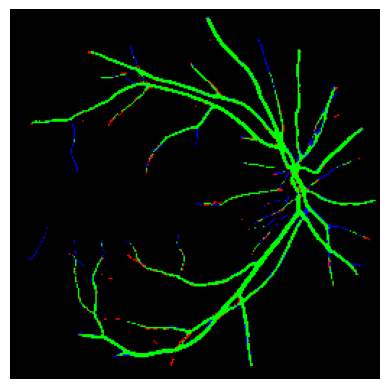

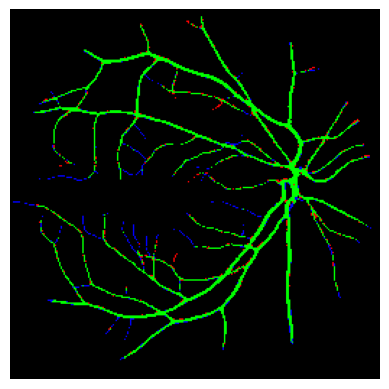

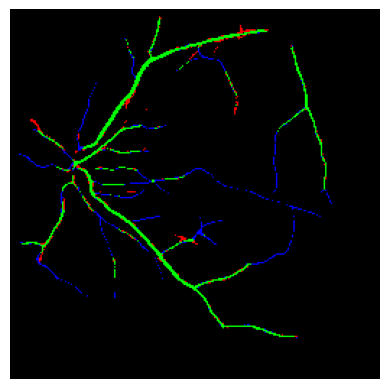

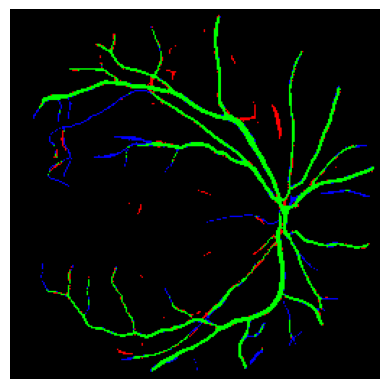

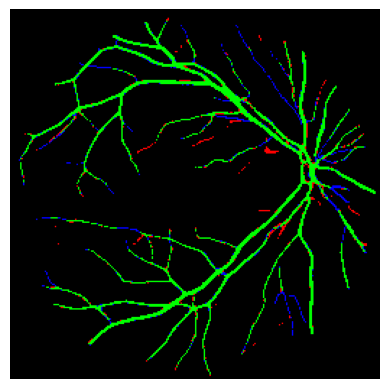

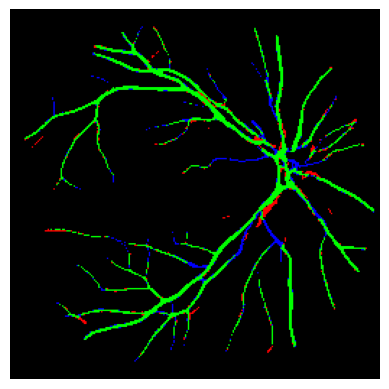

1/1 [==============================] - 0s 31ms/step


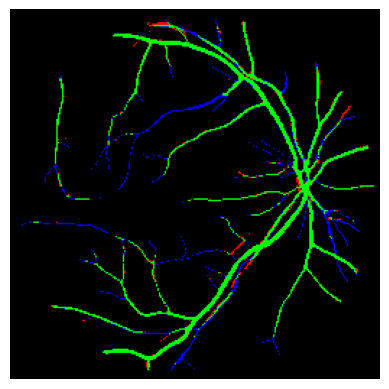

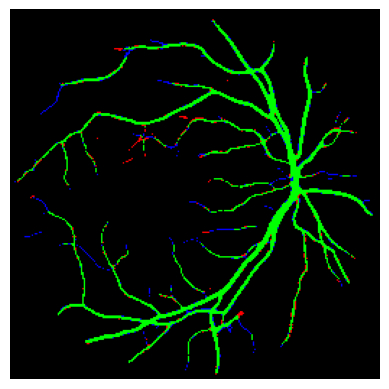

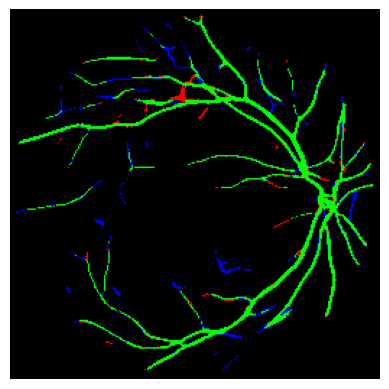

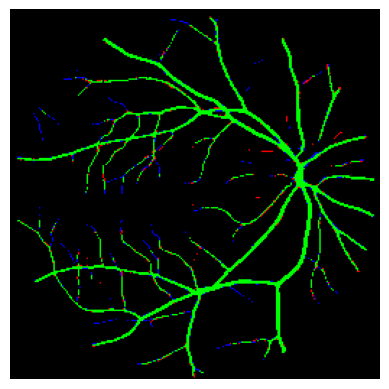

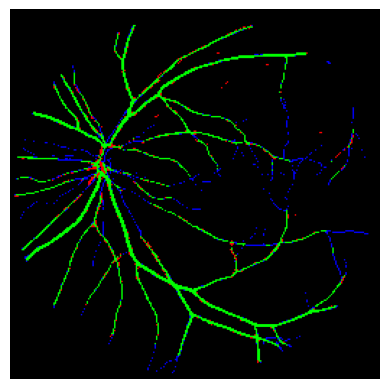

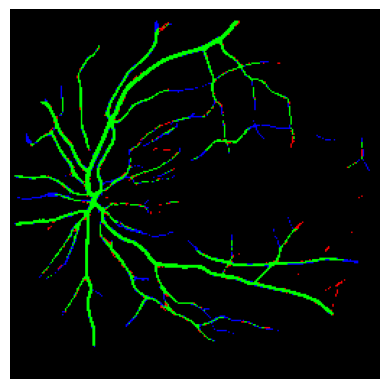

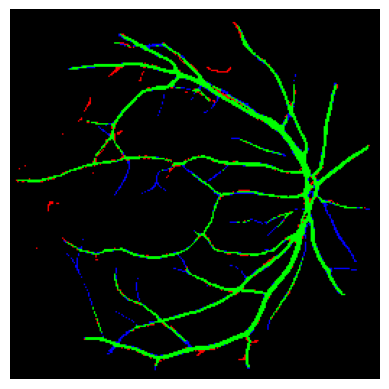

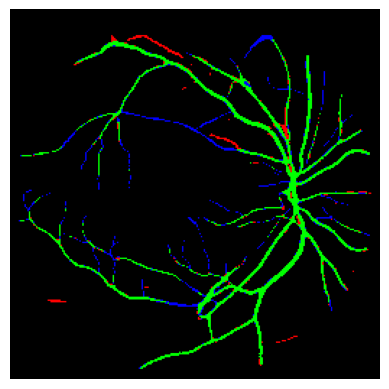

1/1 [==============================] - 0s 33ms/step


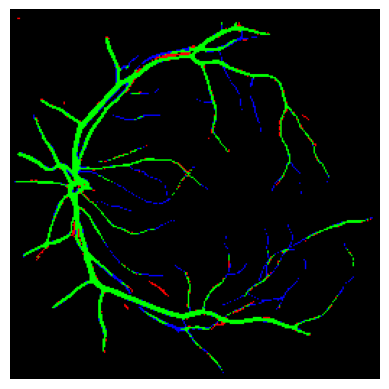

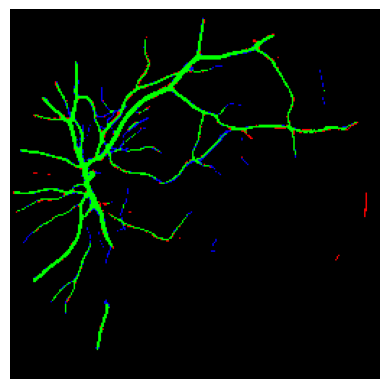

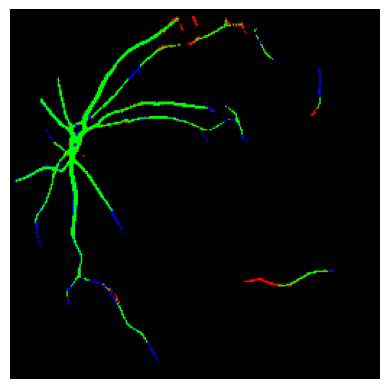

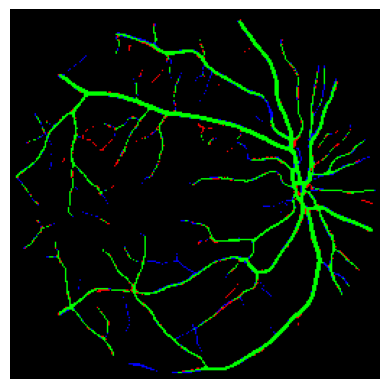

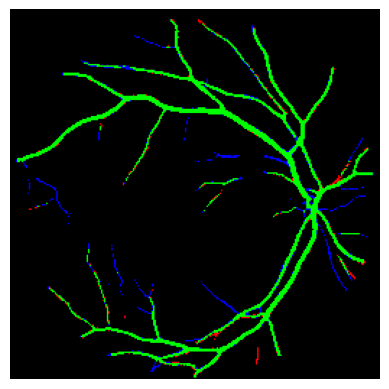

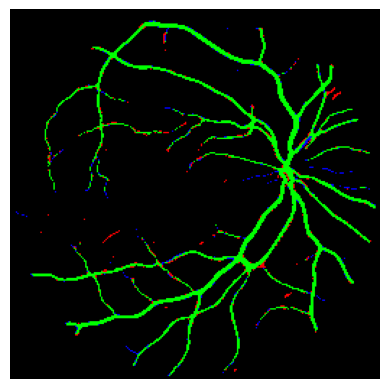

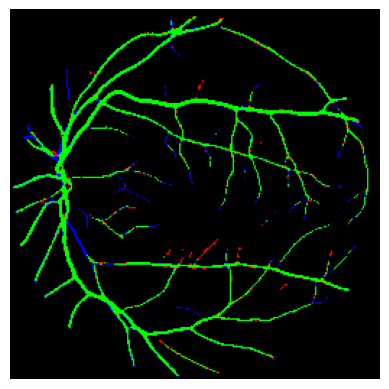

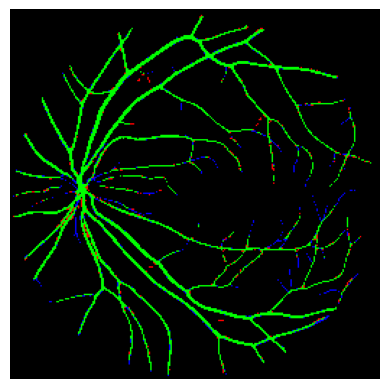

In [24]:
import matplotlib.pyplot as plt
import numpy as np

# true posivies (green), false positives (red), and false negatives (blue)
green = np.array([0, 1, 0])  # Green
red = np.array([1, 0, 0])    # Red
blue = np.array([0, 0, 1])   # Blue

# Create a function to apply the color mapping to the predicted binary mask and plot it
def plot_result_image(image, mask, model):
    # Predict the binary mask for the image using the model
    pred_mask = model.predict(image)

    pred_mask_binary = (pred_mask > 0.5).astype(np.float32)

    batch_size = image.shape[0]

    for i in range(batch_size):
        # Create a mask to visualize matching areas (green), false positives (red), and false negatives (blue)
        match_mask = np.zeros(image[i].shape)

        # where predicted and ground truth masks both equal 1
        match_mask[(pred_mask_binary[i, ..., 0] == 1) & (mask[i, ..., 0] == 1)] = green  # Green (matching)

        # where predicted mask is 1 but ground truth mask is 0
        match_mask[(pred_mask_binary[i, ..., 0] == 1) & (mask[i, ..., 0] == 0)] = red  # Red (false positive)

        # where predicted mask is 0 but ground truth mask is 1
        match_mask[(pred_mask_binary[i, ..., 0] == 0) & (mask[i, ..., 0] == 1)] = blue  # Blue (false negative)


        plt.imshow(match_mask)
        plt.axis('off')
        plt.show()


for image, mask in test_dataset:
    plot_result_image(image, mask, m1)


In [25]:
#Test with DRIVE dataset
import os

#Define the paths to the dataset folders

drive_image_folder = '/content/drive/MyDrive/Drive_dataset/Images_png/'
drive_mask_folder = '/content/drive/MyDrive/Drive_dataset/Masks_png'

drive_image_files = os.listdir(drive_image_folder)
drive_mask_files = os.listdir(drive_mask_folder)

drive_image_paths = [os.path.join(drive_image_folder, filename) for filename in drive_image_files]
drive_mask_paths = [os.path.join(drive_mask_folder, filename) for filename in drive_mask_files]

drive_image_paths = sorted(drive_image_paths)
drive_mask_paths = sorted(drive_mask_paths)


In [26]:
import tensorflow as tf

IMAGE_SIZE = 256
BATCH_SIZE = 20


def read_image(image_path, mask=False):
    image = tf.io.read_file(image_path)

    if mask:
        image = tf.image.decode_png(image, channels=1)
        image = tf.cast(image, tf.float32) / 255.0  # Normalize to [0, 1] for mask images
        image = tf.where(image >= 0.5, 1.0, 0.0)
        image = tf.image.resize(image, [IMAGE_SIZE, IMAGE_SIZE])
    else:
        image = tf.image.decode_png(image, channels=3)
        image = tf.cast(image, tf.float32) / 255.0  # Normalize to [0, 1] for RGB images
        image = tf.image.resize(image, [IMAGE_SIZE, IMAGE_SIZE])

    return image

def load_data(image_list, mask_list):
    image = read_image(image_list)
    mask = read_image(mask_list, mask=True)
    return image, mask

def data_generator(image_list, mask_list):
    dataset = tf.data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    return dataset

drive_dataset = data_generator(drive_image_paths, drive_mask_paths)

print("Test Dataset:", drive_dataset)



Test Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(20, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(20, 256, 256, 1), dtype=tf.float32, name=None))>


In [27]:
def calculate_metrics(model, drive_dataset):
    accuracy_scores = []
    dice_scores = []
    tp_scores = []
    tn_scores = []
    fp_scores = []
    fn_scores = []

    for image, mask in drive_dataset:

        pred_mask = model.predict(image)


        mask = mask.numpy()

        pred_mask_binary = (pred_mask > 0.5).astype(np.float32)

        mask_flat = mask.flatten()
        pred_mask_flat = pred_mask_binary.flatten()

        # Calculate True Positives, True Negatives, False Positives, and False Negatives
        tp = np.sum(mask_flat * pred_mask_flat)
        tn = np.sum((1 - mask_flat) * (1 - pred_mask_flat))
        fp = np.sum((1 - mask_flat) * pred_mask_flat)
        fn = np.sum(mask_flat * (1 - pred_mask_flat))

        # Calculate accuracy, Dice score
        accuracy = (tp + tn) / (tp + tn + fp + fn)
        dice = (2.0 * tp) / (2.0 * tp + fp + fn)

        accuracy_scores.append(accuracy)
        dice_scores.append(dice)
        tp_scores.append(tp)
        tn_scores.append(tn)
        fp_scores.append(fp)
        fn_scores.append(fn)

    # Calculate and print average accuracy and Dice scores
    avg_accuracy = np.mean(accuracy_scores)
    avg_dice = np.mean(dice_scores)

    print(f"Average Accuracy: {avg_accuracy:.4f}")
    print(f"Average Dice Score: {avg_dice:.4f}")

    TP = np.mean(tp_scores)
    TN = np.mean(tn_scores)
    FP = np.mean(fp_scores)
    FN = np.mean(fn_scores)

    f1 = 2 * TP / (2 * TP + FP + FN)
    recall = TP/(FN+TP)
    precision = TP/(TP+FP)
    specificity = TN/(FP+TN)
    MCC = (TP*TN - FP*FN)/ np.sqrt((TP+FP)*(TP+FN)*(TN+FP)*(TN+FN))

    print("Precision Score:", precision)
    print("Sensitivity/Recall Score:", recall)
    print("Specificity Score:", specificity)
    print("F1 Score:", f1)
    print("MCC :", MCC)


calculate_metrics(m1, drive_dataset)


1/1 [==============================] - 4s 4s/step
Average Accuracy: 0.9560
Average Dice Score: 0.7205
Precision Score: 0.7971235
Sensitivity/Recall Score: 0.6572652
Specificity Score: 0.9841904
F1 Score: 0.7204697148093878
MCC : 0.7006286


1/1 [==============================] - 0s 29ms/step


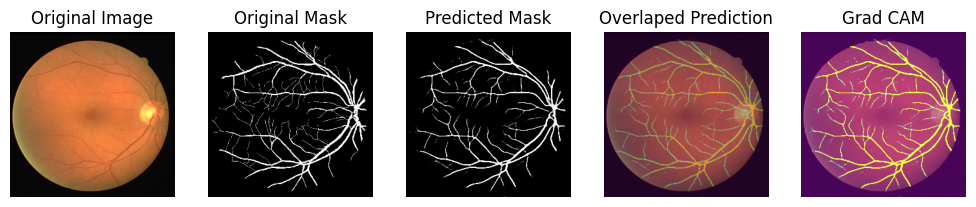

1/1 [==============================] - 0s 29ms/step


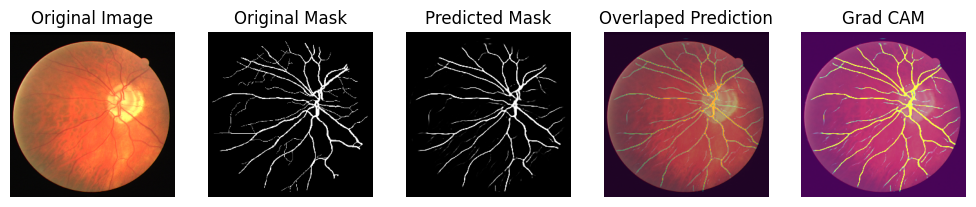

1/1 [==============================] - 0s 32ms/step


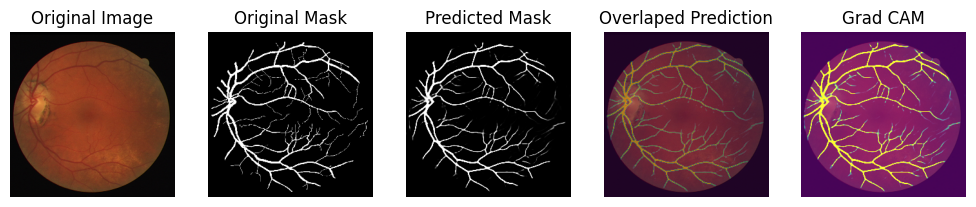

1/1 [==============================] - 0s 31ms/step


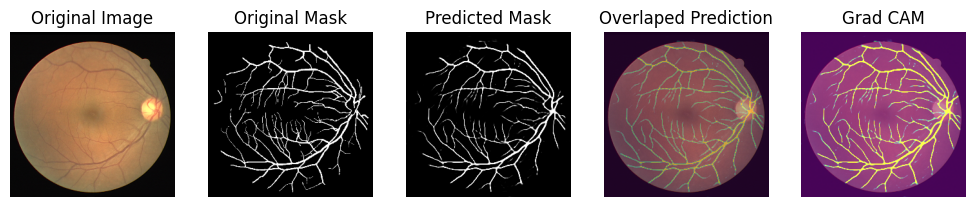

1/1 [==============================] - 0s 31ms/step


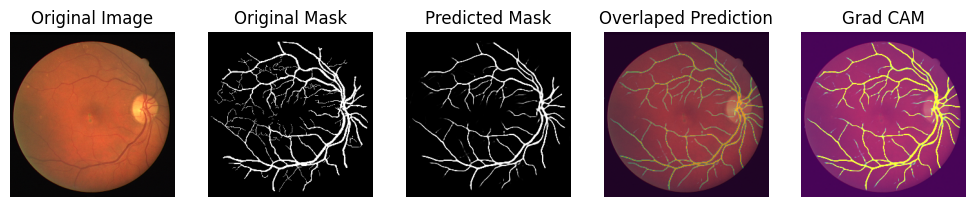

1/1 [==============================] - 0s 32ms/step


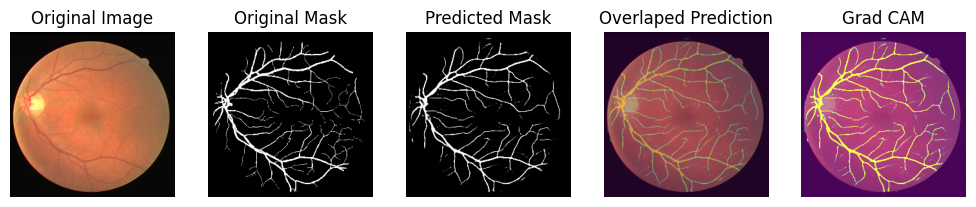

1/1 [==============================] - 0s 30ms/step


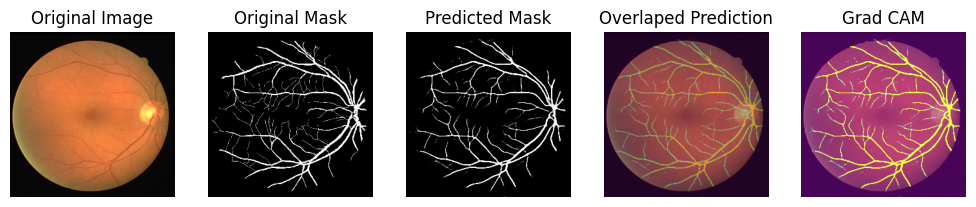

1/1 [==============================] - 0s 30ms/step


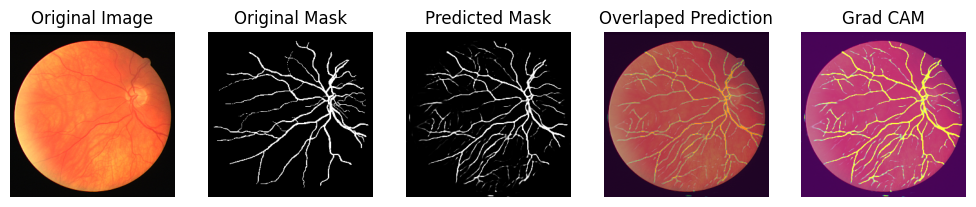

1/1 [==============================] - 0s 31ms/step


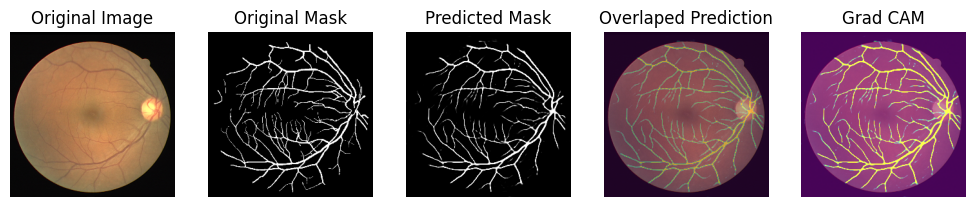

1/1 [==============================] - 0s 30ms/step


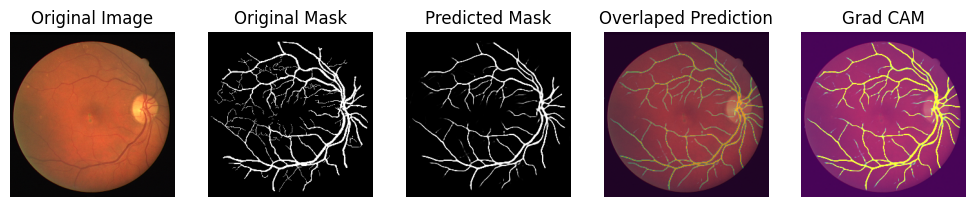

In [28]:
show_images(drive_dataset, model=m1, explain=True, n_images=10, SIZE=(20,8))